<a href="https://colab.research.google.com/github/pranay8297/Stable-Diffusion-Experiments/blob/main/Stable_Diffusion_with_Diffusers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install -Uq diffusers transformers fastcore ipdb

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 9.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 31.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 34.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 50.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 67.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 70.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 31.1 MB/s eta 0:00:00


In [17]:
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionPipeline

from fastcore.all import concat

from huggingface_hub import notebook_login
from PIL import Image

from ipdb import set_trace as st
from tqdm.auto import tqdm

# Using Pipe

In [3]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16).to("cuda")

unet/diffusion_pytorch_model.safetensors not found


Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.
/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [4]:
!ls ~/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4	version_diffusers_cache.txt  version.txt


In [5]:
pipe

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.21.4",
  "_name_or_path": "CompVis/stable-diffusion-v1-4",
  "feature_extractor": [
    "transformers",
    "CLIPFeatureExtractor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [6]:
prompt = "a photograph of an astronaut riding a horse"

  0%|          | 0/50 [00:00<?, ?it/s]

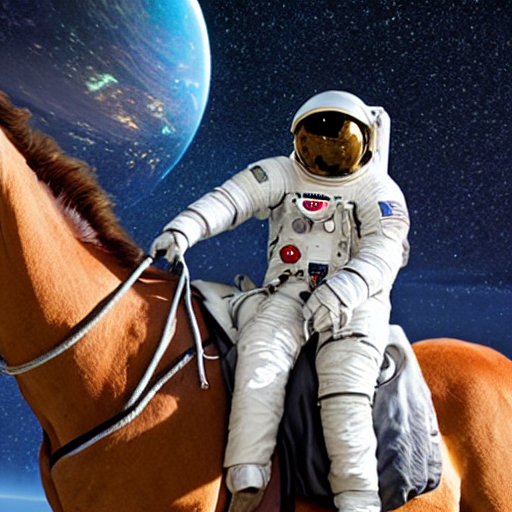

In [7]:
pipe(prompt).images[0]

In [8]:
?? pipe

In [9]:
pipe.__dict__

{'_internal_dict': FrozenDict([('vae', ('diffusers', 'AutoencoderKL')),
             ('text_encoder', ('transformers', 'CLIPTextModel')),
             ('tokenizer', ('transformers', 'CLIPTokenizer')),
             ('unet', ('diffusers', 'UNet2DConditionModel')),
             ('scheduler', ('diffusers', 'PNDMScheduler')),
             ('safety_checker',
              ('stable_diffusion', 'StableDiffusionSafetyChecker')),
             ('feature_extractor', ('transformers', 'CLIPFeatureExtractor')),
             ('requires_safety_checker', True),
             ('_name_or_path', 'CompVis/stable-diffusion-v1-4'),
             ('_class_name', 'StableDiffusionPipeline'),
             ('_diffusers_version', '0.21.4')]),
 'vae': AutoencoderKL(
   (encoder): Encoder(
     (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
     (down_blocks): ModuleList(
       (0): DownEncoderBlock2D(
         (resnets): ModuleList(
           (0-1): 2 x ResnetBlock2D(
             (norm

  0%|          | 0/50 [00:00<?, ?it/s]

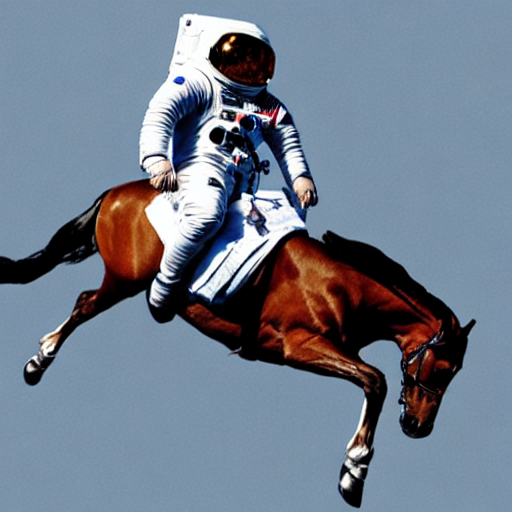

In [10]:
torch.manual_seed(1024)
pipe(prompt).images[0]

  0%|          | 0/3 [00:00<?, ?it/s]

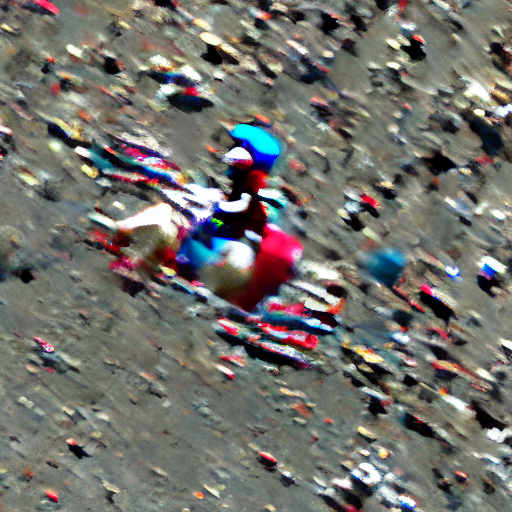

In [11]:
torch.manual_seed(1024)
pipe(prompt, num_inference_steps = 3).images[0]

In [12]:
num_rows,num_cols = 4,4
prompts = [prompt] * num_cols

In [4]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [14]:
images = concat(pipe(prompts, guidance_scale=g).images for g in [1.1,3,7,14])

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [15]:
?? concat

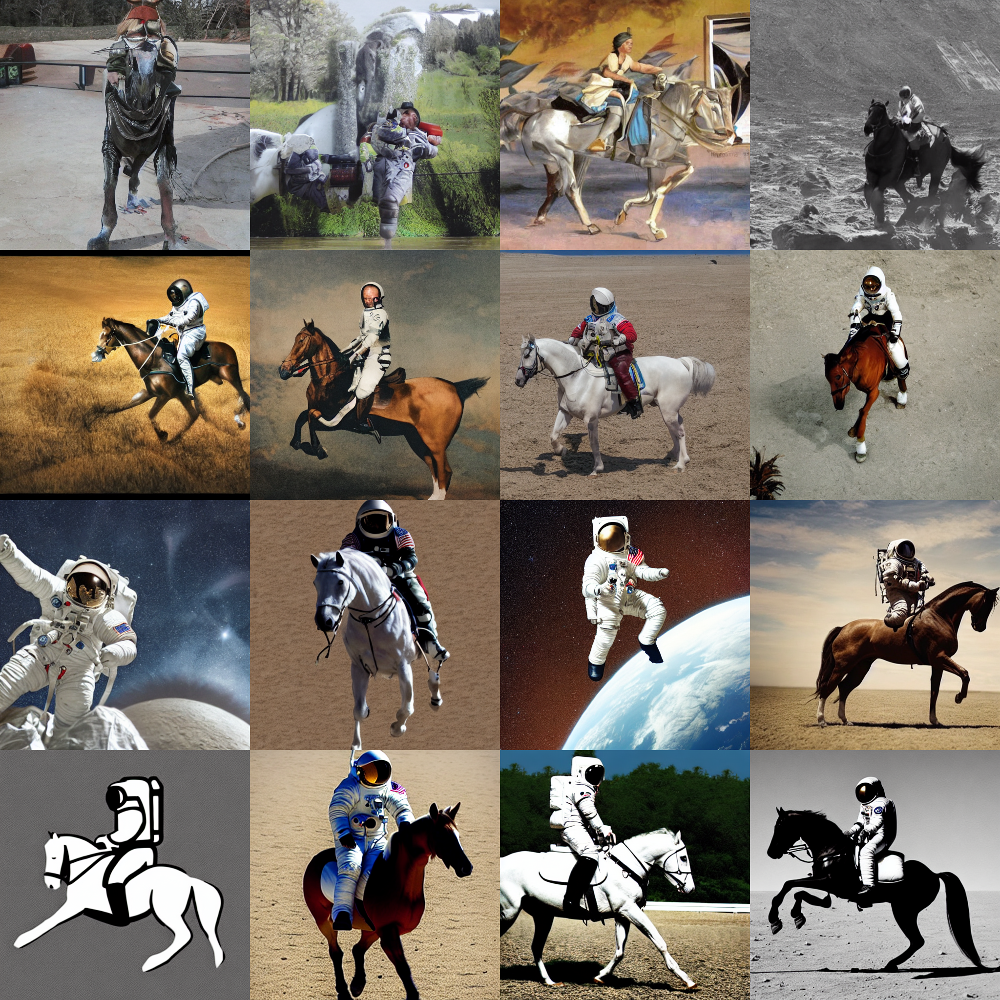

In [16]:
image_grid(images, rows=num_rows, cols=num_cols)

In [ ]:
pipe

In [ ]:
torch.manual_seed(1000)
prompt = "Labrador in the style of Vermeer"
pipe(prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

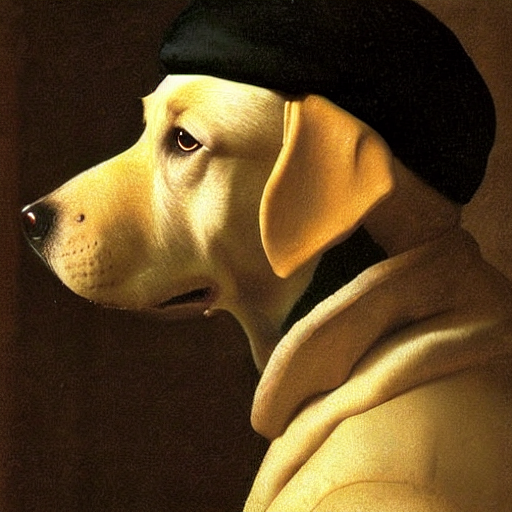

In [18]:
torch.manual_seed(1000)
pipe(prompt, negative_prompt="blue").images[0]

In [19]:
from diffusers import StableDiffusionImg2ImgPipeline
from fastdownload import FastDownload

In [20]:
pipe = StableDiffusionImg2ImgPipeline.from_pretrained(
    "CompVis/stable-diffusion-v1-4",
    revision="fp16",
    torch_dtype=torch.float16,
).to("cuda")

vae/diffusion_pytorch_model.safetensors not found
Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


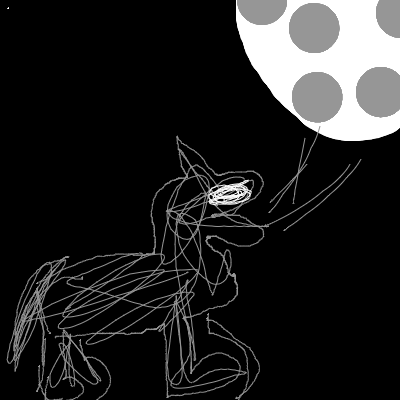

In [21]:
p = FastDownload().download("data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAZAAAAGQCAIAAAAP3aGbAADUaUlEQVR4nOy9dUCT+/v/f68TGLURG92M7lYJSUGwQOz2eLo9x2MdT3hsPcY55jGwsLAFJCQFpLu7x8gBi98f9++97z4DxggZ4v34C+7dcQ3dc6+4rucFAyAgPnB4PN6ZM2ckHcUobNu2TdIhzDrOnTvH5XInfTl8GkOBgJAUMBhM0iFAjE90dPRU1AqABAtibsDj8SQdAsT4lJWVTfEOyGmJAwJCssBgsDmmWZWVlfHx8SwWa9RX4XA4Go2WkZGh0+l6enozHNvkKC4unvpNIMGCmAugUKihoSFJRzEN5OXlpaenj/teuFwui8VisVgtLS0xMTEoFEpHR2fevHkzEuMkSUxMnPpNIMGCmAuQyeT6+npJR/F/QCIn9uFKSkrKy8vjcrmTWI8bHh4uKioqKioiEomrVq2a6OUzA5vNnvpNIMGCmAvY2trONsGSkpIS88z4+PjCwkLw5ynuHvT29p49e5ZGo/n5+U3lPtPOgwcPpuU+Yy665+TkTMsDICBmAAqFIukQhJk/f744p926daugoGAan8vj8Wpra8+dOzeN95w6DAZjWu4zumBlZ2fT6fRpeQAExMyAwWAkHcL/A4FAiKOhFy9e7OzsfB85GVwud1blpg0ODk7LfUYXLHNzcwQCMS0PgICYGdzd3SUdwv9DVVV13HPOnDkzXR/jsTh79ux7vf/MA+VhQcwR1NXV4fDZ8v953CWkmRn+zJ4agCnmi/KZLf/AEBBTx8jIaDakvBMIBNEnzPDAZzZo1nT9u0CCBTF3cHFxkfggCw6Hr169WsQJZ86cmfkc19mgWdMCJFgQc4rAwEAJPh0GgxkaGoo44Z9//pmxYIQ4f/68pB49jUCCBTGnoFAoioqKkno6Eol0dXUd69X09HQOhzOT8QgyPDz833//Serp0wUkWBBzjSVLlkw0y3y62Lhxo4hXs7OzZyqQ0enr65PUo6drFgwJFsQcZNOmTTO/+i7a/SouLk6Cwys+ly5dkshzoUV3CAhRbN26dSYfN65X37R4FUydsewf3jfTldcJCRbEB89YOT7btm2bmfzncdWqs7NzuhKRpo5EBllycnLTch9IsCA+eERMtTZv3vxeNQuJRIrjg/zy5cvZkCAGIpFB1pIlS6ZlGQsSLIgPnt7eXhGvbt68mUwmv4/nKioqbtq0SZwzp6v0d7rIzMyc+YdOi2RDggXxwZOVlSX6hJCQkGXLlk3XUAsGgyEQiODg4CVLloh5yWxzQ83NzZ35h6JQqKnfBBIsiA+e2NjYcc+Rl5ffvHmzrKwsDAabylc9HA43NjbevHmz+IY29+7dmz3zQRCJuLP6+PhM/SaQgR/EB8/Tp08PHDggzpkrVqwAAKCmpiY+Pr63t3dCOoLBYNzd3dXV1ScaHpPJnOgl7xuJ7ACoqqpO3XofEiyID56JJmSqq6uD5X5FRUV5eXldXV1cLlfwgwR+rmAwGAqFIpPJtra2UzEInJ1m862tre9paU8EBgYGRUVFU7kDJFgQcwE2mz2J7HZDQ0PRpX/TwuxJaBCkvLx85gVr3rx5xcXFUxlkQWtYEHOBmpoaSYfwgdHU1CSR5zo4OEzlckiwIOYCEtn2+qARnQvy/jAzMxO/PcdIIMGCmAvMGb+nGUOCK2vh4eGTti2DBAtiLvDq1avZubY9a5GUoQXIli1bJnchJFgQc4TU1FRJh/AhoaCgINkAxClpGgkkWBBzhM8//1zSIXxI6OvrSzoEYNu2bRNNqYUEC2KOkJ2dPRsMpz4U9PT0JB0CAADA1q1bJ6RZkGBBzB3q6uokHcIoSEtLSzqEWc3WrVuxWKyYJ0OCBTF3uH79uqRDGAVnZ2dJhyDMbGuTvG7duuXLl4uzdTi7ajIhIKYCgUCQVHqRaGZb1oWent6sapTNJzo6ury8XEQqPCRYEHOKpqYmJSUlSUchzKVLlyTlTTwqk9uhmzEaGxufPHnCZrNHvgRNCSHmFAkJCZIOYRSsra1njyXWbJsPjkRFRWXTpk3btm0zMDDA4/FwOJy/MA+NsCDmFAEBAY8ePZJ0FKNw9uzZWaJZurq6Hh4eko5ikkAjLIg5RVRUVEFBgaSjGAUTExNJhwAAAIBEIj9ctQIgwYKYe3z//feSDmEUnJycJB0CAABAYGCgpEOYEpBgQcw1njx5IinvFNEYGBhINgAsFjvzHljTCyRYEHOQL774QtIhjML8+fMxGIykng6DwdatWyepp08X0KI7xNyEy+XOttYPIJJafV+2bJm8vPzMP3d6gUZYEHOTzs5OSYcwOlu3bp35hy5cuHAOqBUACRbEXOXy5cuSDmFMtm3bNpODLFtbWy0trRl73HtlNo6ZISCmjrq6enV1taSjEMXM1Ouoqan5+fnNwINmBkiwIOYsLBZLgovc4vDPP/+8V0scNzc3IyOj93f/mQeaEkLMWUpKSiQdwjhs3rz5PRXKwGCwbdu2zTG1AqARFsQcxsbGJj09XdJRjE96evr0ug9isdg5kMEwKpBgQcxlmEzmh+KfFxcXN8Umo8CclioQSLAg5jKPHj0KCAiQdBQToLW19eXLlz09PRO9cM5LFQgkWBBzmUWLFj18+FDSUUyG4eHh+/fvMxgMHo831rALBoNRKJQFCxbIyMjMcHiSAhIsiDlOWVmZjo6OpKOAmB6gXUKIOc7sNG+AmBzQCAti7gMNsuYM0AgLYu7z2WefSToEiOkBGmFBfBTU1tbSaDRJRwExVSDBgvgooFAoTU1Ns9NwBkJ8oCkhxEdBS0tLYWGhpKOAmCqQYEF8LOzevVvSIUBMFWiEDPERUVFRMWecoT5OoBEWxEfEypUrJR0CxJSARlgQHxfQduEHDTTCgvi4mBmfT4j3BDTCgvjoyM3NnSV9mCEmCiRYEB8d2traeXl5OBxO0oFATBhIsCA+Rvbv3//zzz9LOoqPgszMzLy8PBaLNdIkBwaD8Xg8BAJBIBCWLl2KRqPHvRskWBAfKampqXZ2dpKOYs7y6NGjhoYGUJLEvAQGg2EwmIULF6qoqIx5zjSFBwHx4QGlZb0PQKma4k3MzMwcHR1HHocEC+KjhsFgkEgkSUcxR3j8+HFdXd103Q0Oh2/ZskXoICRYEB87w8PDSCRS0lF88Fy8eHFwcHDab0skEletWsX/FRIsiI+doKCg+/fvSzoKUTx69Ki1tXV4eHjUV2EwGIFAoNFo8+bNm9m4/h9nz56dYr8fESCRyE2bNoE/Q4IFAQFERUX5+/tLOor/Q01NTUxMzITGLOCOm7W1tZWV1fsLbCSnT59+3749/OkhJFgQEAAAAAMDA1gsVtJRAAAAREZGtra2TvEmMjIyYWFh0xKPaN7r2EoQGAy2detWSLAgIAAAAHbs2HHy5EnJxpCZmTmNraphMJi9vb25ufl03XAk//77L5vNfn/3FwIGGTBCQPCprq5WV1eX1NOvXLnS398/vfeEwWAoFGrDhg3Te1uQ8+fPj7Ws9v6Aip8hIP5/Rm6izxhnzpyZdrUCAIDH4w0NDZ0+fXra73z16tWZVysAEiwICD4vXrxIS0ub+ee+bwMJGAw27Y/o7e2d3huKCTQlhID4fygpKVVUVODx+Bl74kza3Wzbtm1a7nPu3Dkulzstt5oo0AgLAuL/0dzcvG/fvhl73Aybc03L45KTkyWlVgAkWBAQQvz5558xMTEz8KD3sbQ0LlPXrJycnGmJZHJAggUBIYyHh0dzc/N7fcSFCxcktUf/77//Tvra8vLyaYxkEkCCBQExCsrKyn19fe/p5tnZ2RLZYgNhs9nR0dGTuzY+Pn56g5kokGBBQIwOkUh8T1mRqampM5MdPhZlZWWTu3BoaGh6I5kokGBBQIyJrKzstN/zxo0bklUrkIsXL070EomrFQAJFgSECHp7ew8cODC992QymdN7w8kxCSuYO3fuvI9IJgQkWBAQovj555+rqqqm626ZmZnTdaupc+3atQmd//4W9cQHEiwIiHHQ0tLicDjTcquMjIxpuc+0MNFs9en6I0wFSLAgIMbHzMxsWhaeZsNnng+Px4uKihL//NnglQAJFgTE+BQUFFy5cmWKN4mLi5sNn3lBWlpaxD95NuwVQIIFASEW69at6+npmcodprFBw3Qxk25W0wIkWBAQ4vL9999P5fLZsGj9oQMJFgSEuJw5c6awsHDSl8+GKZUQPB6vurpa0lFMAEiwICAmwIoVKz64aZRoUlNTJR3CBIAECwJiAuTl5Z07d07SUXy8QIIFATExduzYkZWVJekoJMBs2OKEBAsCYsJYWVm9b/+ZWchsaIMGCRYExGRQVlZuaGiQdBQziomJiaRDgAQLAmKyUKlUiRvazSRWVlYSnxVCggUBMXl0dXVfv34t5smzMK0BAABDQ0PxT5b4W4AECwJiSixYsCAiIkKcM3E43PsOZhKYmZmJf7Kqqur7i0QcIMGCgJgqYWFh4oyzKBTKDATzXlm0aJFkA4AECwJiGliwYMG4KeO+vr4Sn1JNHckOsiDBgoCYHjQ1NcfdN5T4orUQKBRqopdIdpAFCRYExLRBpVJF52dhMJgZC0YcfHx8JnEVjUab9kjEBBIsCIjpRHR+lru7+0wGIxoYDDa5+Z2/v7+klBcSLAiIaYZKpY7l3a6urj7DwYjAwMBg0teuX79eItNbSLAgIKYfa2vr48ePj/oSmUye4WBGBQaDzZs3byp32Lp168zvIUCCBQHxXvjiiy+Cg4NHfqRDQkIkEo8QOjo6U7/J9u3bp34T8dHS0oIECwLifXH//n1TU9ORx21tbWc+GEHgcLiHh8e03Grbtm1IJHJabiUaOTm5hQsXzq5NVgiIOUl/f79QmvuVK1f6+/slFc/y5cvl5OSm8YYXL16cRGdW8XFxcaHT6QA0JYSAmAHweHx7e7vgkTVr1kgqGCwWO71qBQDA+vXr35P5DAwG27ZtG6hWAABAIywIiBkiLi7Ozc1N8MiZM2dmOAYYDLZ169b3dPPy8vLo6Ghg+mqkR0YLCRYExMyxa9euvXv3CiYEzKRmvVe14hMVFdXQ0DBFzUKhUD4+PiPTxCDBgoCYUSwsLJKTkwUnUDOjWTOjVnwePHjQ0tLC4/EmpFw8Hk9KSmrVqlVjnQAJFgSEBCgrKxNMLHjfmjXDaiXI8+fPq6uruVyuiERTBAKhoqLi7+8/7t0gwYKAkAw5OTmCSQ9XrlwZGBh4H6mYJBIpNDR02m87OXJycoqKipSVlQ0NDSeRQwsJFgSExCgvL9fW1ub/mpOTk5KSMo2aBYfDFy9ePEty66cFSLAgICRJR0eHUJLBhQsXhoaGpnhbGAxGJBLDw8OneJ/ZBiRYEBASZmBgYGQS06NHj5qamjgcziRqjKlUakBAwDRFN7uABAsCQvKMTIXnc+PGjZ6eHi6XK/oOcDgcjUYbGxtLvO7nvQIJFgTErKCvrw+Px4s+B1yxFjyCw+ECAwPfZ1yzC0iwICBmC3PA8f19A9USQkDMFmAwWEVFhaSjmNVAggUBMYvQ0dE5ffo0h8ORdCAQEBAQ4uHi4lJWVsYbj1evXhUWFo572lwCGmFBQMw6EhMTdXV1d+7cOTAwIOK0hoYGFRWVGYtqNgAJFgTELOX33383Nja+efPmqDPE1tZWLBYrIyMz84FJCjs7O0mHAAEBMR7y8vKvX78WmhxlZGQkJSVJYlomAfr7+7W0tABohAUBMfvp6OiYP3++g4NDQUEB/2BNTc2sahr2/igpKVFWVq6srJR0IBAQEBNk0aJF1dXV3d3dFy9elPS4573DYDC+++47Sf/JISAgpsbu3btfvnwpaT15jwwNDd2+fXvkG4emhBAQHx49PT1ff/31jz/+2NHRIelYppmWlpY//vhDVVV12bJlko4FAgJiypDJ5D/++IP/66efftrZ2SnpIdFUGRoaunXr1rS0d4X4uLC0tJR0CBCi8PX1Xbp0qdDBb7/9tqmpSdKyM2GGhobevXu3bt06ifwlIT54Nm7cePDgQUlHASGK3bt3a2pqjvrSggULkpOTh4eHJS1E4zA4OJiTkxMWFjbR9w6tYUH8H9BoNIFAcHd3l3QgHynjJoIaGxsPDAxUVVWN+mpsbKyjoyMKhQoPD8/MzGSz2e8hximRkZGxefNmDAZjZmZ248YNSYcD8YHj7Ox84MCB7du3SzqQj5SwsDBXV1cRJ2zcuFH0CUIsWLDg8ePH3d3dEhlJDQ8Pl5SUXLt2bcOGDU5OTsrKylP8+yCneD3EHKO/v7+9vV1NTc3NzS0+Pl7S4Xx00Gi01NTUsV5VVFQ0NDS8fPmy+DeMjY2NjY0FAIBCoSxdutTc3NzAwMDAwEBWVhYOn84JFjjR6+rqam9vb25urqqqOnXqVG5u7jQ+AoAEC0IINBrd29sbFxfn4+Nja2v7119/STqijwsqlVpfXz/Wq66urm/evJncRK+lpeXUqVNCz1q9erWFhYWurq66urq0tLSYEjY4ONja2lpXV9fc3JyRkZGampqbmzv3EiwgPgA0NTV/+OEH8Ocvvvhiw4YNko3no4JKpe7atWusV/F4/OnTp+Xl5WcypNkGtOgO8X9gMBiKiopEIhEAgGfPnsnIyBAIBEkH9bEgeni1YMGCxMTEj3wgAwkWxP+BSqUODQ2BHYlLSkqGh4d37drFH3NBvFeoVGpdXd2oL+HxeHd3d3A16mMGEiyI/0N+fn5ycjKdTgd/PXny5E8//cThcE6dOjVv3jz+cYj3gYgRlpeXV2pqaktLywyHNNuABAtCmIKCAjQazf+Vw+H89ddfly9fNjEx2bJli5WVlQRjm9vQaLRRBYtMJnt5eb18+XLmQ5ptQLuEEMLgcLiRTT0zMjIyMjJ0dXWDgoKIRCKU8TDtkMnk/v7+3t7ekS/5+flFRUUxGIyZj2q2AY2wIIRBIpGjfmwAACgrK0tPT58/f35oaKi0tPQMBza3GWsBy9TUlEajPXv2bOZDmoVAggUhzPDwsIqKirm5+aivxsfH79+/n0AgfPvtt97e3jMb2lxmrAUsBweHFy9ezHw8sxNIsCCEgcPhsrKyGzduHMuQiMPhnD9//vbt22ZmZj/++GNAQMAMRzgnGXUBi0gkmpmZvXv3TiIhzUIgwYIQJj8/H+zUYmFhIcKgNi8v788//3z69Kmqqur+/ftnMsI5yagjLBsbm9TU1KGhIYmENAuBBAtiFFJTU7u6urhcbn9/v4eHh4gzc3Jyzp49++7dux9++AFKepg0JBIJBoN1dnYKHbe1tX379q1EQpqdQIIFMQoaGhr9/f05OTkoFMrX19fPz0/0+c+ePaurq9u2bZuxsfHMRDjHGHV4paOjg0aji4qKJBLS7AQSLIhRqK6uxmAwYGlOYWHhuEOngYGB69evnz171svLKzAwcGaCnEuMKliOjo4pKSkSiWfWAgkWxCgYGBgoKCioqallZmZqaWkNDQ2J48GUl5d37949Gxub4ODgGQhyLjFyxZ1EItnb2yclJUkqpNkJJFgQo5Cfn5+Tk2NmZhYVFZWSkkIkEr29vTEYzLgX1tTU/Pzzz3p6euvXr5+BOOcMysrKDQ0NgkdcXV3j4uIGBgYkFdLsBBIsiNFhMBgcDgcAgKioqK6urqGhIfHHTX/88YeGhgaU7iAmUlJSMjIyTU1N/CNIJNLV1TUhIUGCUc1OIMGCGJ2+vj4ymQz+/Pz5cyQSaWZmJv761P79+83MzBYvXvzeApw7qKur19TUCB6ZP39+fn5+c3OzpEKatUCCBTE6TU1N/DlgWVnZ+fPniUSira2tmJcPDw8/ePDAw8PDzs7uvcU4RxgpWAsWLICcZEYFEiyI0ens7GSz2SgUCvy1urr6xYsXWCx20aJFYt4hPz//v//+8/b2hvKzRKOurl5dXc3/1dPTs6ysrLa2VnIRjc/3339vYWEx88+FBAtidOrr69lstqOjI/9IVFRUSUmJp6cnjUYT8yZpaWmPHz9euHDh+4lxjiA4wkKhUJ6enq9evZJsSKJxdXXt6+uTSMEQJFgQY1JZWSmUCHrr1i0Oh7Ny5Urxb5KZmSkjIwNNDMdCUVFxeHi4q6sL/HXhwoW5ublj+Y7OBnA4nJ+f35MnTyTydEiwIMYEiUSCG4V8mExmRESEsrLyhGZ50dHRampq0x3dHEFweEUikXx9fWe5N8OiRYsyMjLG6uT6voEEC2JMmpub5eTkhA6mpaVVVlZOqMl4RkaGnZ0d6BMPIYSgYPn6+r58+bKtrU2yIYnAyMjIxMTk4cOHkgoAEiyIMSkvL1dQUAA76Ahy/PhxHA4npFn+/v4hISGjOmT19/dfuXLFw8NDVVX1PYb7YcIXLG1tbRMTk6dPnyopKR06dMjExESCUX3zzTcjvbBhMFhISMi9e/ck6B4BCRbEmKipqfX09IzqPvrkyRNHR0d/f38AAExMTL788ksDAwMEAuHg4PDpp5+OPD8vL6+/v9/Ly+u9B/2hwRcsf39/cGFo3bp1jx8/zsvLk1RIdnZ2HA4nMzNT6PiyZcsqKiqysrIkEhUIJFgQY8Jms2VlZUe18YuOjmYwGAsXLvzxxx8DAwOLiopu3bp1+/bta9euIRCIvXv3jlxlf/PmjYWFBdTDQhA1NbXW1lYWi+Xs7AyDwd68ebN+/fqSkpK4uDhJhYRAIBYtWjTSkdnGxkZfX//27dsSiYoPJFgQY5Kfn5+ZmTnW3ITL5cJgsMHBwV9//fX58+fgxlZZWdmxY8cyMjIWLly4Y8cOwVSd/Pz8kydPurm5QcbKfMDhFYFACAwMfPToUWho6NDQ0L179yQY0tKlS3Nzc4uLiwUPUiiUsLCwmzdvstlsSQUGAgkWhCj+++8/Lpf72WefCR5UVlb+/PPP29vbnz17pqKi4uzsLHRVVFTUvn372tra1q1bZ2Njwz9eVlZWUFBga2u7YcMGKNEBAABlZeWurq6goKCUlBQjIyMKhXLx4kUJxmNhYaGvr//gwQOh4+Hh4VFRUaWlpZII6v8ACRbEOCQlJenp6QlO5fT09Nhs9pkzZ548edLZ2bl8+fJRfftu3bp1/Pjx4OBgwcTRFy9e7Nu3D4FALFu2zM3NbSbewCxGSUkJBoPp6uoyGAxzc/MLFy5IMBhZWdmwsLA7d+4MDg4KHl+1alVzc/MsKRWC+hJCjMPLly/JZPL8+fP5q7AGBga1tbXg7OC///774YcffH19CwoKRl5bUVERGRm5cuXKhoaG/Px8/vF//vlHVVU1PDycQCA8ffr0fb8FCwsLNBoNg8GwWCybzWaxWNLS0rPhE6ikpEQikQoLCz09PU+cONHT0yPBYNasWRMdHV1YWCh40NfXV15e/tixYxIKShhIsCDGh8Fg2NjY6OrqlpWV6ejoyMrKRkZGgi/V19e/fPnSxsZm0aJFjx49GnltRkYGjUZbu3btrl27BN2dGhoa8vLynJycamtrBbVMBC4uLsPDw729verq6j09PZ2dnaWlpU5OTggEAoVCweFwGAyGRCLxeHxTUxMcDkcgEFgs1tzcHA6Hg6MGBAIxPDyMx+NJJJKqqmpkZGR/f/90/IUmAxwOJxKJDAbDwcHhxIkTkvVmCA0NZTAYQjmrzs7Otra2R48elVRUI4FJOgCID4Pw8HAVFZWDBw+amJhoa2sLLXPs27cPg8EkJiY+fvx41Ms9PDycnJz27dvH4/EEj4eEhGhqah46dEjEo93d3QkEgpGRkaysbEdHBxKJlJGR6e3t7e3tRaFQOTk5MBgMhULBYDAAABAIBA6Ha2lpQSAQCAQCjUYPDg4mJib29fUJ3tPZ2dnFxYVEIsXExBQWFo7aEPB9Y2houGPHDhgMdvLkSckat3t7exsZGR07dozL5fIPWlhYrFy58vjx47OqTggSLAixcHBwWLZsWUpKiq2t7fnz54V2kWxsbBYvXiwtLX3hwoWxamK9vb1dXV1v3LghNJ766aefqqurGQzGu3fv+CZ2CgoKQUFBPT09+vr67e3tGAyGwWDcuHFDKGURi8WyWKxJvylTU1NQthISEhITEyd9n8nx008/qaio/PPPPzk5OTP8aEGcnJzACalgzx4jI6MdO3YcP368pKREgrGNBBIsCHHx9PRctGgRg8H45ZdfRr76+eef19bWurm5vXv3Lisrq729fXBwUKhv1ZIlSxwcHA4fPtzY2Mg/6Orq6ufnh8VimUxmQkKChYUFkUiUkpJCo9H9/f0NDQ0PHz4UdF+ZXshk8oYNGwgEQktLy8mTJ9/TU0bi6ekZGBiYlZUl2W1BS0vL0NDQkydPCrrZ6Ovrf/7552fPns3NzZVgbKMCCRbEBDh27BgCgRiZyw6DwYKDg11dXbu6ukgkUmtrKwKB6OnpGRgYqKurE6zsd3Nzc3JyOnz4sNBW1JIlSywtLbFYLAaDgcFgubm558+fn7Gsn8DAQE9Pz0OHDr0/ZRREU1Pz66+/ZjAY9+7dk2BXZzqdvnnz5r///ltwGGVgYLBt27bLly/PznbTkGBBiIu3t7evry8Sidy+fTt4xMrKSl9fX1dXF4PBFBcXq6qqpqenl5WVrV+/PjExMT4+3tLS0tbWVl5e/vnz52lpaeBVISEhKioqUxzOIBAIMzMzOBxOIpHgcHh/fz+bzZaWlu7u7s7Pzx+1nEg0mzZtkpGRefLkyfteTtLU1Pziiy9qa2tlZWX//vtvQSv3mQSc9J0+fVpohn769Ol//vknOztbIlGNCyRYEKPwxRdf9PT09PT0YDCY1tZWKSkpLpfr4eEBLsru3bvXwsLC2dm5o6Ojubn53bt3YEqhvr7+smXL9u/fT6fTV69effv27YyMDAAA9PT0VqxYkZ2dzd9G3LlzZ2Fh4cgExXFxc3OjUqk0Gk1NTa2hoaG5ubm7u5vH42EwGDweD66+6+rq1tfXFxcXj7UDMBaffvqpjIzMr7/+OtGoxEdbW/uTTz6BwWB79uzZvXv3N998I7jOPWPo6el98cUXz549i4qK4h+Uk5P77rvvkpKSBA/ONqC0Boj/wyeffEKhUOTl5Xk83vDw8PDw8MDAAJfLlZWVHRgY+Pfffy0tLT/99NPS0tJLly4JmSKVlJT09PQEBgY+fPjwn3/++eyzz5SUlB4/flxaWvrnn39+++239fX1YOlsTk6On58fmPguTlTq6uqBgYFUKrWmpqaxsfHmzZt1dXVCXl18YDCYk5OTi4sLGo2eUJnLpUuX9uzZY2Fh8Z5mQ/r6+lu3bu3u7n7+/DmJRGpqapKIWuno6Gzbtu38+fNCZcyrV69+/fr1LHfjggQLAjA3NwcAwNbWVlNTk0AglJaW3r17t6Kigp8KoK+vv27dusbGxpUrVyYlJf31119jpTjGx8d7eHgAAFBeXv7y5UsnJ6fExEQmkzk4OPjgwYPVq1eXl5d3d3c/efKkrq5u/fr1J06cEOq/IIisrKyVlZW1tTUWi62srLx582Zra+u4b4fH471586ampsbAwAA8oqqqqq+vHxsbC4fDzczMOBzOqMvJvb29jx49sre3f0+CtWPHjry8PDabnZKS4uTkJLjzMGPo6elt27bt+vXrQmq1cuXKjo6OWa5WACRYHzmrV6+Wk5MjEAgoFAqJRObl5d28eXPk1354eLiUlFRycjI4xRPBu3fv5s+fb21tnZGR8fjxYx6PFxYWdubMGQAA8vPzU1NTPT09waTT3Nzce/fuhYeHHz16dGT2prq6uq+vr56eXkZGxv379yexuY5AINzd3cFiFwqF8u7du6ioKAwGg0Ag4HC4srLyqB/O/v5+ft+NaURNTe2rr77KyMgwNjYGp5w0Gm3mV6/AVfbLly8LqZWPjw+ZTJ5VCaIQEMLs2LHj5MmTa9asweFwIk7bunXryZMn9fX1xbytiYnJjz/+KHi5n58f+LOCgsKff/4pePLSpUtXrVoldAdTU9PTp08vWbIEDp9krSsKhXr06FF3d3dMTExKSkp5efnBgwcBAADbZ9ja2n777bejXmhmZrZv377ly5dP7rmjIicn9+uvvzo5Of3888/8UvBvvvnG0NBwGp8yLjY2NidOnBjpbe3k5LR3714SiTSTwUwaqPj5Y2Tt2rVr1qxRUFB4+PDhlStXRPRDDwsLo9Pp58+fF3+Mk5eX19fXZ29vD/4aERHh5OQEdmBtb2/v7u7W1NTkn3znzh11dXVLS0v+ERcXl9WrV//99993796d6BIPDof76quvcnJyGAyGkpJSVFSUo6NjXV2dj4/Pd999BwAAmLTNYrEIBMKod8jJyYmKilJWVp7Qc0WAxWK3bt0aFxenpqZWUVHx9u1b8DiVSp3JKeGCBQuCg4OPHz8utCdoZmYWHBx84cIFfheMWQ40Jfy4cHd3d3R0pFAo5eXl+fn50dHRIk5evHixlZXV/fv3J5qKHR0dHRwcnJqaCgAAk8lMTk62tbV9+vTp8PBwQ0MDhUIRXK2/e/cuuEDW3Ny8ZMkSPT29EydOjNuVD4PB6OrqamhoqKioUKlUZWVlKSkpa2trRUXFO3fuDA0NWVpa1tXVrVmzZqTnHAKBGGvBHgAAHo83jRbA27Zty8/P7+npsbe3/+2338CDcnJyXV1dTCZzup4impCQEF1d3aNHjwqtAOrr62/ZskUoa3SWAwnWR0RgYOC8efMKCwvPnz8vegEFBoOtW7eORCINDQ3FxMRM9EGFhYXz5893cnJKSkoCAODx48cEAiEkJOTmzZtdXV0yMjKCJxcXF8fExISFhfF4vK6urqNHj4IjPkNDQycnJyQSmZCQwLcQWLFihZeXl7m5uYmJSU1NDdivAYlEYjAYHR0dJpNJIBA2bNiQk5Pj6OiYnp4+VoQiap7RaPSkp6JCbN++vb6+Pi0t7Ycffvj777/5A0YNDY2ZqV7E4XCrV6/m8XhHjhwRUmEtLa0tW7b8+++/ki1jnCiQYH0sEIlEMpn85MkT0aMqAAAUFRXXrl1bV1fH4/Em7SweHR0dHh4OChYAAJGRkbt27QoICBgaGhq5qs1isVxcXHA4XHl5ua+vr4aGhoGBQXNzc2pqKo/H271798DAQFdXl76+fm1tbUJCws2bN1+9emVlZSUlJaWsrKygoNDc3NzY2KigoNDR0ZGamkomk48cOXLo0KFRU73Kysrc3d3HilxXV5c/cZsKGzduZDKZd+7c+eKLLx4/flxeXs5/SV1dfQYES0tLa9WqVTk5OSP/CBoaGtu2bbt58+bsTGcXASRYHwsbN24sLy8fV61MTU3Dw8NfvHhRX18fHh5++fLlyT2upKSkpqaG38SYzWZnZGR4eXklJycLFuUoKip+/vnnq1evbmpqwuPxqamp8fHxtbW1JSUl8+bN8/LysrCwUFJS6ujoUFFRQSAQmpqaGhoaKBQKHK0gkcienh4Oh6OpqcnhcNrb29va2ry9va9cudLc3Lx3796vv/567969Qu/azc1trBIcNzc3FRWVkf0XJsq6devYbPb169dDQkKYTKbQKFVDQ2Pcf4gp4ubmFhIScv36dX6BAR9NTc1t27ZFRkaKGIHOWiDBmvvA4fBvvvkGjUaLk/nt7++flJQUExPz3XffgXkJk37u06dPv/3229TUVDBpKyoqqr6+fu3ateAcJCgoaP369fb29jAY7MyZMwcOHLC1tTUzM7tz546Wltbp06ddXV1ZLJa8vHxOTg6bzcZisRoaGgwGA4lEKioqIhCI58+fv3379vPPP//+++/l5eWVlJTKy8vJZLKNjY2/v7+cnNzDhw8TExMvX768fPly/lhPSUnJxcXl+vXrIwNWVlZWV1ePi4sT059rLNasWQODwS5dumRvb29kZARuUAryXkdYWCx2+fLlioqKf/75Z0NDg9Crurq6W7duvX379kghg4CQMDgcTk9P79NPP129evWoLsZCzJ8/f+vWrQAABAQEbNy4ceoBhISECKUIhIWFHT9+3MTEpLW1NTExcdGiRYKvfvfdd7du3eJwODk5OdnZ2XFxcXV1dSwWi8fjdXd3l5SUpKen19fXDw8PDw0N8Xg8Lpfb09Pz9u3bvLy8O3fuPHz48NixY6GhocuXL+/o6ODxeBcvXrx79+6pU6f4j1i1apWnp+eo0VpYWHz33Xegr9akWbt27fr16wEAUFNTO336tJaWltAJioqKu3btmsojRECn0/ft2xcSEjLqq8bGxidOnIAaF0HMRjAYzA8//LB///61a9eK08EUi8UePHhQXV3d2tr6999/F1oanxw4HO6vv/4S7FPv7Oz8yy+/lJeXv3nzRujkDRs2tLS09Pb29vf3d3Z29vf3Dw8PDw4O9vT0dHd3Z2VlpaSkMBgMFos1ODhYUlJSVFTU1dXF4/F4PF57eztY6MNkMnt6eiorK9PS0lgs1tDQEHhaaGgoAABycnLHjx8f2c4aAAAkErlx48Ypdk7csGHDunXrAADAYDA///yzk5PTyHMcHBxWr149laeMChwOX7p06f79+83MzEY9AczDkmx/1qkD5WHNWZYuXcrlcnft2nX58uWRU4OR+Pr6ZmZmghUtz549m5ZN94GBgadPn/r6+vKPqKur29nZycrK1tbWgn1YQS5fvnz69GlFRUUul9vQ0NDd3Q2Hw8vKyvz9/Y2MjMLDw9FotJ2dXX9/f3FxMQwGq6qqiouLi4mJ2bJly/DwcF5eXkNDw9u3b7/++msqlXr06FEUClVVVZWXl5eenl5bW7tz586EhITY2FiwccbIUBUUFOTk5F6+fDnpN7tt27bBwcFLly4BALB69erCwkL+PFToQR0dHZN+yqjQ6fRdu3ahUKgDBw6MmoMyf/58MA9Lgv1ZISDGZOvWrb/88guY2C0OJiYmP/zwg7S0NAAAO3bsEGf+KD47d+4EE0fpdPrp06eTk5P/+usvPz8/cED3zTff9PT0MBiM2travr6+1tbWzs7OvLy8tLS00NDQGzdutLS0cLncvr6++/fvb9261dPT09jY+LPPPvvkk08UFRUBALC2tq6rq+vt7f300085HA5/qa6goKCjo2NoaCglJQWNRp89e7a0tHSscmgikfjtt98qKSlN4g3i8fivvvpq6dKl4K9BQUHgzHpU1qxZ4+rqOomnjIWjo+PRo0fHGlgBABAYGLhz587JvbXZBrToPgfZtGkTkUg8dOiQ+B0WrKyssrOzu7u7AQDQ0dG5cePG1MMwNTWtra2lUCidnZ3W1tZNTU2rV6+uqKjQ1dXNzMzU1NR0cHD45ptvmpubW1paOjo6LCws0tLSrl69CoPBpKSkvv3228uXLw8PD6NQqB9++AFcupaVlfXy8vLy8nr8+HF8fDz4IF9fX3DOe/LkydjY2Lt372poaFy4cKG+vl5BQQF0WK6pqamurv7vv/+IROLIUGk0mr+/f1FR0SQ6QSgpKW3evDkrKwsUShcXFzqdfvjw4bHOl5eXn0YnTz8/Pxsbm6NHj46V/Ll27Vo8Hs/PbvvQgQRrrmFlZaWoqHj//n3x1UpHR0dHRwfMYNDU1ATHOFMM49tvv+VwOENDQxgMhsViycjIrFmz5uTJkyEhIY8ePTp79iwMBktKSjp79uyCBQvweDyLxXrx4kV2dnZzc/PDhw/37Nlz5coVDw+P+vr6r776qry8XFlZGXQrjYmJ2bNnT19fn7S09Oeff/7DDz88fvx43bp1Fy5ccHFx6e3t1dXVfffuXWpqKo1Gk5GR8ff3l5aW9vDw2LZtm7y8vGCdIwgGgwkICCgpKZlEiiz4Th89egSqJ51ODwoKOnLkiAh1UFBQAL8Yps7q1atJJNKRI0dGvaGiouKaNWvq6+snnZsCAfHecXZ2FmrUPC47duzgd2/29vZesmTJFGPYsGGD4Lqym5vb4cOHjxw5snLlymfPnjU2NjKZzMbGxl27dq1evXpwcBAc1wQGBjY0NLBYrJaWloaGhuTk5LCwMAAALCwsPvnkk99//x2UHgAAjh07lpCQMDg4eO/ePQMDAxqNFhUV1dzc3NfXx+FwwA5gbW1t2dnZ4P7g119/bWRkFBMTM+owZMOGDWvWrJncOz1y5IjgNqhgefNYnDhxgkwmT+5xfMhk8jfffAP+fcbi4MGDoNXPXAIaYc0pVFRUHB0dy8rKxL/E19eXSCTy9+yMjY2fPXs26QBMTU0XL15cXFx869Yt/v3t7e2HhobQaLSjoyOBQMjKyvL39w8PD//pp58IBEJJSYment7ly5d1dXWzs7MdHBxIJFJjY2N8fPzg4OD169dJJBKLxcJisU5OTsePH9fS0mKxWGg0emBgwNfXNygoiJ+IwOVy4XA4CoUaGBh49uyZgYEBuB4nJSXV39+/YMECoY4PUlJSwcHBqqqqk3MZ3bVr18uXL58/fw7+6uXl1dTUNG6WfHt7uziuXiIwNTVdvXr1s2fPxhoSGhgYfPbZZ0+fPn3f6akzDyRYcwo5OTkUCjUha2B9fX2+E4OioiKFQhHq/SsmsrKyPj4+enp6OTk59+/fBw/u2LFDQ0MDDocPDw9fvnzZzc3NwsICdOy7du1aR0dHZGRkV1fXwMDAqlWrhoeH+/v7b9++3dnZGRIS8sUXX2AwGKGn8Hi8gYEBDofD4/GwWCyYigWDwQYHB7FYbHNzc2hoaEJCwq5du9auXRsUFKSmpmZmZoZCoV6/fp2dnZ2SkiJ4t4ULF8JgsAMHDkzC+fOzzz4rKiriq5WUlFRAQMDIHFEhyGRye3v7RJ8liK+vr4uLy6VLl8Yya9XX19+2bdts9mWfCpBgzR0wGIyPj09paenw8LCYl+jr6xMIBL6+WFtbT64qxcLCYuHCheXl5fv37+dwODQazd3d3dLSsr+//9atWzU1NWvXrs3Ly5s/f353d7eCggJ4FdhZJyAgICEhIT4+3sHBgUwmb9myBQAAMMOew+G0trYikUg5OTmwzQQcDsfj8RwOp62tjcfjycnJweFwAoEQExPj4eEREhIiJyeXnp7e0NDg4eFRVVW1YcOG3t7ewMDAa9eudXd3898pAAC2trYuLi6HDx8W4dwwFmvXru3q6rp79y7/yMqVK0EbVdEX6unpgQXbk0BKSiosLAyJRP75559jucHwe97MSbUCIMGaS7i5uTU1NU1oQufm5sbfawMAwM7O7sqVKxN6KBqNDgkJ0dPTu3PnTltbm4eHh6WlJYFAwOPxmZmZ4N2cnZ0HBgawWKyBgcH9+/f3798/f/78169fUyiU6urq4uJiLpe7YMGCvr6+gYEBsO3F8PAwl8vF4XBycnIYDKajo6O6urqrq0tKSkpaWlpBQUFZWTk7O/v58+dPnz7NysrKzMw8ePDg4sWLN23atH379ps3bwIAoKOjs2DBAkdHx0ePHq1du/bAgQNgAtS8efMMDAxUVFRu3LgxCWeVJUuWoFCof//9l3/EysqKSCTyR1siMDAwEKyCFh8TE5PQ0NCUlBQRHSLodPr27dvn6tgKBBKsOYKioqKzs/OzZ8/E73BFo9E0NTX/+ecf8FdLS0smkynUV0I0AQEBNjY2paWl8fHxXl5eKioqWVlZkZGRmzZtevz4cWxsLHiapqbmu3fvTE1Nc3Jyzp075+zs/PTp0/Lycg6HIyUlhUAgsFhsbW1tbm7uhQsXHj9+zG9HuHPnTisrq5UrV7q7uzs7O6upqamoqMjIyFy5cuXQoUMtLS10Ov3zzz+/detWT0/P1q1bb9y4YWZmBg5zVq1a9dNPPykpKVVWVgYFBe3Zs+fSpUsrV65UV1eHwWDR0dH37t2b6FqSvb29srKyoqKiYKdFAABCQ0PBfNFxMTAwEJqWikNgYKCtre3NmzdF5ENYWVlt2LBhZNuuOQYkWHMEGRmZrq6uCX0YfH19BYdXlpaWoOWemBgaGnp7e7e1tdna2iKRyNjY2NzcXGNj4y+++OLMmTOCGdVaWlqxsbHOzs6lpaVycnLW1ta9vb2GhoZlZWXDw8OvX792dHRUVVU9deqUkBHK4OAgCoUCq4uOHj368uXLY8eOvX371sjIaO3atWFhYfLy8vLy8rdv3z579iz43jU0NHbs2LFu3TotLa2Ojo7GxsazZ8/eu3dPSkpq7dq1AADcuXNnQpsSfFAolLm5OZfLffHiheC4bNWqVcnJyeK0/8HhcC0tLWI2CgKh0WjLli3r6ur6/fffRXwVOTs7BwYGHj16dHJv7QMCEqw5QmVlJdibT8z0KykpKVNTU7AfBAAAcDicTqfzt/bGvTYwMNDBwaGxsfHVq1dZWVngmMjU1HTz5s1CakWj0ZhMJpPJ1NXVVVBQ2LZtG4VCYTKZSCRSQ0PjyJEjdXV1f/75544dO3777bf9+/e3trY2NzcXFBTIysqamprSaDRjY+OkpCQCgeDg4BAaGmpqaspiscrKythsdnNzM2g0uGTJkp07d9rb22Ox2N7eXjKZXFBQcPz48QsXLigrKzs5OdFotLy8PEGBnhBwOPyXX35pbGyMiYmprKzkHzcxMaHRaCdOnBDnJgMDA2N1GxoVd3d30PUwISFBxGne3t729vbHjx+fGVNAyQIJ1hzB2Ni4qqpK/GRR0A6Uv2Nlbm5eXl4+7sfJ2NjY3t7ezMxsYGDg0aNHgo1nrK2tV65cefr0acFNRgsLi/nz51Op1L1796JQqKysrPv376empnI4HDCt9JtvvqmtrR0cHORyucXFxbKysigUysTERF9ff3h4mMlk5uXlDQ4OOjg4+Pj4tLa2MpnM7u5uKpXK5XILCgqGh4evXbtWVFRUWVmpqKjY29v7+++/d3R00Gi0s2fPmpmZhYSEuLu7P3v27OXLl2C318mhpaXV398Ptv8RZPXq1deuXRNzGg6Hw8UsllJSUgoJCYHD4fv37xftDbts2TIajXbs2LEPxZR9ikCCNUfQ1dUVX60AAHBycjp//jz/V0tLS6HWT4KoqalZWVlZWVmBFX88Hu/WrVuC57u6uvr4+Jw+fZo/JbG1tXVzcwMAYGBgID8///79+99///3Tp08BADhz5sxnn3328uXL4uJiNTW1+vp6S0vLgICA2NjYqKio6upqJBLp5uZmaWmprKwMg8FIJFJfX19ycrKUlBQKherr66urq4PD4TIyMlwut6amxs7ODgaDXb58+ezZswAAfP75501NTc7OznJyco2NjXv37m1paZngn1OY8vLy33//Xejgxo0bk5KSxDe8d3Nz6+3ttbOzE+1FBQ6s7t27JzqLCo1Gr1u3jsPhHD16VCINWSUCJFhzATKZPG/evL/++kvM8x0cHNra2vgdTKWkpMzMzK5evSp0mqampqmpqampKRwOf/fu3blz56SkpLZt23bhwgXBfShfX18rK6u///67vr5eXl7ezs7OwcGhtbX15cuXOTk54eHhVVVVNBqNv+X/+++/R0VFeXl5ubi4ODo6SktLFxYWgpPTgYEBCwsLLpdbX18PevWBbQTb29sVFBSkpKTQaDSHw+nt7W37HxUVFdnZ2Xz/g9DQUFAE6+vrhdJEpxcXFxcCgXDt2jXxL3n9+vXr169FnKCmprZ48WI2m/3rr7+K7qmjoqKyZs2a0tJS/qT+IwESrLkAHo/v7u4WvzGnioqK4KDD3t4+LS2N71xsYGBgb29vYGDQ3d2dn59//fp1cNUmICDA29v73LlzgntVYWFhZDL5/PnzGhoagYGBWlpa6enp58+f56uhvLx8Zmamrq6uoCtxfn5+fn7+kSNHpKSk/Pz8VqxYkZWVhUAg9u/fP5W/w5YtW0xNTRsaGt53T1AlJaXAwMAzZ86wWKzpumdAQMCCBQsePHgw7kKbubn56tWrHz58ONElOTgAfOgjMUiw5gJsNrugoICfDTAuMjIyguvijo6O4EjBycnJ3d29t7c3LS3tyZMnQimOFhYWz58/56uVlJTU1q1bYTBYf3//zp07c3Nz09LSTp8+LeSqrKSk1NzcvHDhQtDcXYienp6bN29WVlYuWbLk77//ntC75kMgELy9vXV1dVVUVFJTU0cOFaedL7/8MjIysqKiYlruZmpqGhgYWFdXt2/fPgaDIfpkHx8fFxeXyXW7+dDVCoAEa24gLS0tKysr/vkyMjJ8fz5LS8uBgQFbW9svv/wyKyvrwYMHoyb7LFq0qKamBuz2bmZmZmBgYGtry2Kx3r17V1hYeO7cuVHT6+Xl5QEAYDKZ2tra4ALTqKSnpyMQiG3btt29ezcjI0P8N0KhUGxsbBwcHGpra+FweFxc3Fh2V9PITz/9FBcXN4l0qpEQCITFixdra2s/ePBg3LUwDAYTHh6Ox+P/+uuvcXVtrgIJ1lwADodPqFsEKFiampp2dnZOTk4MBoPJZP75559jVZaoqaktWLDgxYsXn3zyiaGhYUlJiaamZnJy8ri2WXp6emVlZXp6etXV1aJnTykpKYqKisuXL2cymWImE/n7+8+fPz87O/vBgwdmZmZNTU0zoFb79u3LyMiYSn04H7Ahdmpq6v79+8ddNdfV1Q0LC8vLy7tw4cLUH/3hAgnWXMDIyGhCe/YyMjLu7u4mJiYNDQ2dnZ379+8fdTpJJpO1tLS0tbVtbGzYbLa8vHxKSsqFCxc+/fTTZ8+ejTrFE0JFRaWurs7AwECcTvePHj1qaGj49NNPHzx4wM+SF0JeXh7M3qTT6QgE4ty5c6Wlpbt37y4oKBCs7HtP7N69u7q6+tGjR1O8D5VKDQwMxGAw586dE2de6enp6ePjExERMS0NEz9oIMGaC+jo6IhIShDiq6++wmAwBgYGg4ODurq6zc3Nrq6ucXFxeDxeQUFBVVUV7PxOpVL7+/urq6vJZHJTU9Off/4JXr5ly5bq6mpx1AoAAEVFxaqqKmtr65H94kclMzNzcHBw/fr13d3dQnNDaWlpKysrExOToaEhBAKRlJQENk/dvHlzcXHxDKhVcHBwVVXVf//9N5WbwGCwRYsWzZs379GjR6J3DEFkZGSWL1+OxWL/+OOPKZrSzA0gwfrgMTU1BQBAzJJaJSUlCoXC5XLl5ORaWlqGh4fl5eWDg4NDQkLYbDaDwSgvL29oaMjNzQU7Qaiqqu7cuZOfMLlu3ToWi3Xnzh0xY1NRURkeHpaWlhZ/fTo/P/+ff/4BV3Zu3brl7OyMQCDIZLKjo2NhYWFKSorgKENZWVlXV/f9dc3i8/3337PZ7CnKoq2trb+/f1lZ2d69e8XJ87Syslq+fHlCQsKE/ILmNpBgffC0tLSIb9fd3Nx86dKlkJAQDodTX18Pdn4HAIBCocybN8/Q0BAAgKysLP6S/KZNmx48eADW027YsIHL5Ypv54DH43E4HIVCmaiFeXFx8b///rt27dpTp04NDw+3t7cXFxcLZqWCwGCwZcuWPX/+fBpzC0Zl5cqVFArl4sWL/FyNiaKhoeHn54fH4yMiIsTZ3UOhUEuWLNHR0bl48WJxcfHkHjonmVLPSIjZgLS09C+//HL06FFxenkBAGBjY+Pk5KStrd3T03Pu3DnBDyEcDv/0008VFBTS0tKqqqq2bt3KYrFwOFxjYyORSGxra5tQfpONjY25ubmMjMzTp09FmAJ6eHjA4XDQfk9BQaGnp4dCoRgaGsrKyjY0NJSWltra2ubk5AiNbmxtbb28vMrKysSsf5QUUlJSYGLtkydPxEyb0tXVDQ8PLygoiIyMnIRX19wGGmF98GhpabHZbDHVCgAAGRmZxsbGsrIyPz8/KSkpwZe4XO7x48dDQkJ8fHwGBwdZLNaePXvAhqzNzc1MJnP//v15eXliLkhpamq2t7draGiMpVZ//fUXk8mkUCgcDmdgYKCpqYnH4ykrK8vIyHA4nOHhYRqNNjg4GBsbC2bSl5aWdnR0wOFwVVVVKSmplJQUsKxnaGhoaGgIDocTicQJZUW8bxYuXOjj45OQkLB7924xR8Gurq4BAQHXrl0Tv+LnowISrA8eFAo10VIyHo9XU1PT0dGxZMmSsrIyfo47iKysbFFRkb6+PpPJ7Ovr++abb9LS0sASEA0NjeDg4F27dhUVFY27oKOsrNzT0zOWgvz1118EAgGHw2VnZ4M+nDIyMoODg62trVJSUmw2u6enB4FA6Ovra2hodHV1tba2ysvLKyoqwuHwtrY2LpdrYmJiYWGBQCBgMBgCgUChUAgEAo/Hi/Y2mBmcnJwWLlxYVVX1559/il+BsHz5cjU1tVOnTk167jnngQTrg4fFYsHhcA0NDcHaFxGAbgc6OjopKSkoFOqTTz45e/asYOG0lpbWtWvXDAwMCATCJ598UllZyS9Yq66uPnLkiJmZ2YIFC3788ceXL1+KsFRWV1dnsVgj89eRSKSZmVlra6u6ujqbzaZSqQwGQ05ObmBgYHBwEIlEXr16taCgoK+vDwAAc3NzsIi6qKho1LbMcDgcDocDAIBCocDBIJFIbG9v7+/vl4iVnaWlpZeXV19f37Vr18TPNUGj0du3b2cwGGfOnBHfgvEjBFrDmgusXbuWTCaP2wEBxMDAwMvLC4PBPHz4sLS01M/Pz8HB4e7du2A9s5OTk6Wl5Zs3b5ycnEpLSwMDA+Pj40edA5qYmPj7+7e1tUVGRo5MvNbW1t64cWNTUxPoFWViYqKjowNaG5NIJPCTrK+vD6a8pqWlRUREgBcikciRSWG+vr7W1tag28xYKVogdDrd0tISh8PRaLTU1FRwJjsztnampqYeHh4IBOLVq1cTMinW0dHZtGlTfHw86GYBIQJIsOYC8+fPNzc3F3NFXEVFZcOGDQoKCl9++SU4lwRbSLDZ7NTUVDU1teHhYRwOV1NTs2TJkqysLC0trV9//VVo2sjHz8/P2dn5ypUrQptZQUFBlpaWjx8/Li0t9fHxMTY2TkhIYDAYbW1tjY2NQ0NDAADAYDAej4dAIMRZWsZgML6+vsbGxv39/f/++++41l329vbGxsagO82hQ4fE+ctMGhMTE3d3dxwOFx0dPdHczgULFixcuPDOnTuzavVt1gIJ1lzAzs7Ozc1NzBGWsrLyhg0bGAyG0GTN1NTUxsbGwsKio6NDVla2rq6us7PzwoULS5YswWKxInxUzM3NN2/e/PTpU8F0ob/++guFQmVkZNjb20dHRz99+hQUqamzYsUKU1PT9PR0IT/lsfj888+rqqoqKyvfxwxRRUUlNDQUhULFxsamp6dP9PK1a9eSSKTIyMhx2+1AgEBrWHMBLBaLQqHEPLmpqYlEIo3MBsrNzc3Nzf3yyy+7u7thMJiamhoej3dycrp///4PP/wg1F9HkOzs7DNnzixfvjw1NbW9vR1cdcLhcCwWq7W19ccff5yQL/C43Lx5s6ury8jI6Mcff8zOzh63rC8lJWXevHlubm4PHjxITEycrjBUVVVDQ0PhcHhMTMwkeqNRKJQtW7YUFxdHRESMNXqFGAkkWHOBgYEBEolEIBDAhepxAXv5jTyORCJ1dHQyMjJAY/WEhARHR8clS5Y0NTUFBARkZ2fzE0qFyMvLc3d3X7NmjbS0NJPJHB4e5nA4hw4dAnvQTzvPnz9//vy5sbGxj4+PmZlZcXHxw4cPxyr/Tk9PT09PDwsL8/b2VlFRmXreloaGxooVK4aHh9PS0iangC4uLsHBwZGRkfyG2xBiAgnWXACFQuHxeHd3d3HqcpWUlNhstrS09MiXaDRafX29hYXFixcvPDw8SkpK0tPT79y5Y25u7u7u/vvvv1dWVoL58aWlpUNDQ4aGhhoaGqqqqurq6p2dnYqKiqdOnSouLv7hhx8aGhrek1rxKSgoKCgoMDc3t7a2/uOPPwYGBmpra1taWlpaWjIzM4X068aNG5aWlsuWLcNgMBEREeL3mhWETqcvXbq0o6MjISEhOTl5cmGvX79eWlr65MmTgs0sIMQEWsOaIyxatMja2vqXX34Z90x3d3cymWxubn7kyBEhs3NXV1dbW9ve3t6zZ8/a29vT6XQ5OTkikVhaWspgMObNm8dkMvv7+xUUFKSlpWEwWFdXV319fWVlZUFBQX19/erVq+vr62NjY0+ePBkRETHpj/Tk0NHRoVAosrKyampqRkZGZWVlTU1Nvb29dXV1fLdCfX19T09PJBJZXl7+5MkTcTx5sFgsi8Xy8PDw9/cvKCjIzs6etGWCnp7e+vXr09PTnz59+r7LieYqkGDNEXx9fX18fM6dOzfu0vLnn38eFxenra3NZrOFRmSurq7z58/Py8sTNJaiUqkaGhoyMjL6+vpqamqvXr2qr69vbW3lcrkaGho0Gk1VVVVZWRmNRvf29uLx+I6ODlVV1Xv37nV0dDAYjK6uru7u7vfynscGj8drampSKBQ8Hg8mlBUUFHR1dbW1teXk5MybN8/IyEheXj4uLk7EnG7jxo0vX75cunQpiUTKz88vLCwUtGmdKMuXL9fT03v69OkkFrwg+ECCNXdYtWoVl8u9fv26iHPwePzvv//+9ddfUyiU7du3//TTT4Kvamlp7dix4+LFi2Opnqenp4mJyZEjR0a+hMPh5OXlv/32WwAAmpuby8vL5eXlZWVlwcW17u7u3t7e3t7e/v5+MEF0aGiop6envb29q6urp6eHxWINDw/zeDwkEonFYolEoqysrKKiIgAAbW1tDAajt7eXxWKx2Ww4HI7BYAgEgpycHIVC4fF4LS0tHR0dPT09Q0NDMBgMjIRGo/F4vPr6+paWFhqNpqWlJS0tbWBgICsrW1JSUlFRoaurS6VSORwO2B6tvLy8urpaS0uLRqNlZma6u7tbWFhUVVUxGAwEAjEV2zwTE5Pw8PCsrKzo6Gh+swyIyQGtYc0d+vr6VFVVRZ9jYmKSn58P1h62trbOmzcvLi6O/2pDQwMWixXRFOvVq1dKSkqhoaH8PE8+AwMD9fX1vb290tLSf/31l2DyJwKBkJaWJhKJBAIBtHDAYDAYDIZMJhsaGpJIJCKRyN/o5HA4LBart7eXyWSCpvJ0Op1/DgKB4PF4Q0NDvb29DAYDtIiytLSUlZUlEoloNJrH47FYLAaD0dDQwOVyHRwcwFktHA4H+4N1dnZqamqamJjA4XAOhwODwRQUFGAwGJhPD1rUu7u7w+HwoaEhHR0dGAw2ldTzr7/+msvl3rx58927d5O+CQQfSLDmDng8nkgkij5HQ0ODb031+vVrHx8fQcECP8MqKipC7ScEuXr16s6dO728vEYtlJGSkqqurhZKVedwOAwGQ4I25FgsFg6Hs1gswaJLMGEVBoMhkUh7e3tvb++4uLi2tjYwSV1ZWbmpqcne3j4vL0/MvdeRnDx5Misr69KlS9PyLiAAAIBLOgCIaaOysnLcVhTKysr8AVRubi6bzba0tOS/qqamNjg4OO7n8+bNm15eXkJODwAAgOnyaDR64rG/X1gsVn9/v1CJOJhez+PxhoeHExMTb926paenB/rEAwAAViynpqZORa3u3r0LqdX0Ao2w5g40Gg0GG2dRUklJSXDGV1xcvGrVKtBrGAAAdXX1vr6+UVO0BKmsrHzz5k1QUJBgQy0SieTn5wf+QCaTPzg/XzBv1tXVddmyZf39/aKbM4vmm2++IZPJt2/fnsY8VQgQaIQ1d8jPzx8YGBCR8g6uAbW3t/OPPHny5O7duzt27JCTkwMAQF1dvaura9x5JQAADx480NLSMjMz4x9ZtGhRcXFxbm5uTk4OnU6f2luRGAkJCa9evdLS0pr0HcLDw1VVVSMiIiC1eh9AgjV3QKFQKBRKREqkqqrqSG+mpKSk6Ojozz//nEQigZZ7446wQHJzc93d3cGfTUxMtLS0cDhcRkZGcXGxnp7epN+FxKmvr9fX15/05deuXfvyyy+hJfb3BCRYcwcCgSC6+TOVSh3VTC42NjYxMfHbb7+FwWC1tbVKSkriPO7+/ft4PF5fXx8Ggy1evDgnJweFQmVnZ1dWVmpoaEzuLcwG2Gw2m80WvzYTYiaBBGvuwGAwRJcZjzrCAomOji4tLQWT2jU1NcV8YmJiorOzc0hISEVFhaGh4YsXLwAA6OrqAk1dJhj+bKGlpQWJRI5augQhcSDBmjvU1NTIy8tjsdixTlBVVQUX10eloaGhvr7+u+++k5GREfPj+ubNG9CnGAaD1dfX8+dBra2tZDJ5ovHPEthstpyc3OSKDSHeN9Au4dxh3rx5SCRSRJHaWFNCkN7e3sbGxqSkpBUrVtjZ2YnTKhVM8uRwOBQK5fDhw/zjnZ2do46w3N3dEQgEmOQ1NDREpVLxeHxzc7OOjg4AAIJ7jhJkcHCwqalp5suJIMQBEqy5Q3t7+9DQUEBAQFRU1MhXFRUVOzs7RcwZBwYGcDjcmzdv6HQ66MSSlpYmuine6tWrMRgMDofbvXu34PGenp6RWVpeXl5BQUGDg4NcLheNRvf09ODxeB6Px+FwsFgsl8tls9l5eXkSMWIXBCzrMTQ0FKeBIMQMAwnW3CEtLQ2NRoONoEeipqZWX18v4vLBwUEMBgMAQEZGBhwOr6urCwsLKy4ujoqKGlXmqFSqsbFxdna2nJycqampYFuq/v5+HA4ndL6/vz9YKohAIAAA2LlzJ2jgBWac6+npge7yr169qqurm5An+jSCw+G8vb2vX78OqdXsBBKsOQWHwxnLvlJdXV1070I2m41EIgEAaGhoUFBQAD1/PTw89u3bV1paWltb297eXl9fLyUlJS8vr6ura2Vl1djYeOXKFWdnZ2tra0HBGh4eHpnM9eDBg+DgYLDhIOg8AyaRgxnnpaWlpaWlISEh5ubmXl5e4G7j69evp/b3mBiampqLFy/u6OhISkqayedCiA8kWHMKGo1GpVJHfUldXV30shSPxwMT5ZuampSUlFAoVG9v74MHD2JiYgwNDclkMp1O9/T0xGAw9fX1nZ2dXC4XXHXKzMwMCwu7fv06f/mMy+WCrbcE8fPzYzKZQv4QQkRGRkZGRhoZGTk7O1taWpqZmWVnZwtWO74//P39yWRyR0fHuJ7LEBIEEqw5BZvN7urqGvUldXV10Z0O4HA4v9quubmZTCaDI7Kenp6R7RVWrlwZFxcHzjEHBgays7PNzc1TU1PBV8F2OILnb9myBYlEXr58WZx3UVhYCDaLDgwM9Pb2xmKx9fX173Vta8GCBaampm/fvhVnqwFCgkBpDXMKDocz6vYchULp6OgYy5EdBI1G8xvbtLa2gl5Uo2JoaKivry+4tJ+RkeHk5MT/dWTnrsrKSh6Pp6amJt77+P95+PDh48eP6XT61q1bDQ0NJ3St+Ghra5uamsbGxkJqNfuBBGtOoaCgAK5DCUGn08ftfo7D4QYGBsCf29vb5eXlxzozODj44cOHgln1WVlZKBSKX0LIYrHweLzgJa9fv2YwGJ6enuP6SQjx5s2bQ4cOxcfHb926NSAgwN3dfeHChbq6uhO6iQhWrVq1Y8eOuro6/vAQYjYDTQnnFDU1NUJKAUImk8cVLGlpab5g1dbWWllZxcTEjDwtKCiovr5+pM9vQkKCq6srOHFraWmxsLAQfJXNZsfExPj7+6urq0/CGOvOnTvZ2dl0Ol1WVpZAILi5uZWXl1dVVdXX10+uqzOdTreysjI1Nc3Ozj59+vTMtIaGmDqQYM0pYDDYqHZUKioq4zYWJpFI/Cz5rKyssLAwaWlpofxJIyMjOzu7AwcOjLw8OTnZ39+fSqXW19e3tbUpKCgInVBbW9vZ2blmzRoHB4czZ85M4F0BAAAAZWVlfFmRlpa2tLRUVFT09fVNS0vr6ekBq4LGRVFR0dHRUV1dnUwmR0dHP3jwQPQ0GWK2AQnWnIJIJI46JVRRURGd0wAAQENDAz/bk81mZ2Zm2tjYCA6ysFjsihUrbt++PZZlcFJSkqOj4+3btzs7O0G/GkFqa2sPHjy4bt06Op1ua2vL4/Em3X6mu7sb3DpMSEiwsbFRU1Pbv39/fHw8CoXC4XBgtgQKhQJTKFAoFI/HAxsmurm55eTkJCYm5uXliS4Uh5idQII1p8Dj8SNtBhQUFAYGBvr7+0VfC2a68399+/ZtUFCQoGCFh4e/e/dOhHFKSkrKrl27IiMjORxOd3f3yAEaAAC3b98mEAgBAQFwOLy1tXXciapoWlpaHj9+DACAmZkZnU7v7u7GYrHgBiW/nwV4JgwGIxKJd+/ezcrKmsoTISQLJFhzCm1t7ZHtS1VUVETUPPMZGhoSnE4WFxejUChtbW3QA97Pzw+Lxd6/f1/EHTo7O4uLi21tbVNSUkDn0pGC1dfXd+rUKQsLi+Dg4NDQ0D/++EPc9yaSnJwcwcxViLkKtEs4d1i5cqWiouLTp0+Fjos2aeDD4XDAohk+qampDg4OAADY29vb2tqKU5z89u1bGxsbAABYLJYI34h37949ePAAh8N9uC40EBIBEqy5Q3t7+8DAwMjsUHEWsEYlNTXV0dHRysoqNDT08uXL4qxPZ2VlqampycvLg4tHIs7s6+vDYDDbt29fvHjxuLddsmSJv7+/sbHxBKKHmItAU8K5Q09Pz6gr7rKysvyMUBGMzPbs6elJTk5evnz5pUuXqqqqxAzj3bt35ubmo1bnCFJcXPzHH39s3rzZ0dGxr6+vvr6eSCSOTKkHAMDKykpTU5PD4VhbW+Px+Ekv1UPMASDBmjsYGxsLzelANDQ0CgoKxr1cMNOdD9jfdELeCTk5OZ6enlwuV6g6ZyRdXV0HDx7cuHHjvHnzYDAYBoPR0NC4ffu20GlBQUHPnz9PSkpydnZ2dnYuLS2FchE+WiDBmu0EBQWBXUhzc3NFnObv76+jo4NCoTAYjKBhA2iDJc4WPh6P5yeOgtjY2KioqFRVVdnb24ufCJ6fn79+/frm5mYx8wbOnz8PAACRSFy4cKGlpaWysnJHR8e1a9fAVwMDA1taWkD7hDdv3qipqRkbG4NmDxAfIZBgvS/8/PyGh4fZbLaUlFRvby8Oh4PBYHA4fHBwsLOzE4FAYLHYgYEBbW3t3t5eFAolLS0Nh8PBRsTy8vJkMpnJZDY1NRUWFjo6OhKJRAcHh3PnzoE3//rrr9Fo9PDwcEdHB4FA4HK5xsbGXC53YGBATk5OUVERh8NhsVgsFksmkwcGBmRkZMYdlRCJREHfK3V19XXr1h05cgSHw/n5+U2ocqWgoEBLS0uE9+lIent7IyMjo6KiduzY4eDg0NzcHB0dDQCAlJRUeXk5/7SamhpDQ0NIsD5aIMGaPGg0WlpamsPhYDCYoaEhDQ2N/v5+GAxGoVBMTU2ZTCYGgwE1S15eHpwiDQwMKCkpUanU4eFhBALB5XKVlZUBAKBQKDAYjM1ms1gssNwkOztbRkamt7cXj8cXFhZKS0urqKh88cUXWCxWRkaGRCJxOBwmkwleDtpggV2XN23a1NnZ2d/f39fXx2KxyGSygoLCl19+mZ6eHhcXJyIba3h4GDTwAwBAQUFh48aNV69eBcXCy8vLwsJC/NZV7969MzU1nUTP5KGhoSNHjvj5+dnb2w8MDCQlJSkpKQkOLVtbWwVbVUN8bECCNT7W1tZcLheHw7W1taHR6NLSUjab7e7ubmtri8PhiEQi6G3Q2trKYDBQKNTg4GBDQ0NRURHokTISOByuo6NjYGBgZGQkLS2dnZ19586diooKGo0WGhpKJBK5XK6mpiYcDgdN02EwmJSUFJlMBn2ECwoKCgsLlZWV7ezsqqqqmpuby8vLGQzGqA7I8+fPb25uvnfv3rZt29hs9suXL8d6m01NTVZWVgAAkMnkrVu3xsfHp6SkgC/FxMQEBgaKL1hZWVkbN27E4/Fjed2IpqioyMTEJDQ0FPz7COZkyMvLQwtYHzNzQbC++uorPB6voqJSW1v76NGjsWRiolAoFD8/P01NzdbWViQSyeFwOBwOEol0dHSUlpbu6+tLTEwsKipSUFAoKioik8nt7e18P6lRMTMzMzIyUlNTU1dXLy8vLy8vv3fvXmlpKf+E2traP//8c9Rrjx49eu3atbS0tOXLl5PJ5MDAwLS0tGPHjo1MExWira3N2Nh4YGDg33//3bp1qwjBAmVXT09v7dq10dHRsbGx/JfAwuPg4OB79+6JfhyIrKxsX1+fqampOPlfI6msrPzjjz8CAwMdHR1LS0sFW1WzWKyRRT8QHw8ftmCFhoZaW1tjsVhwfReLxQqud0waJBIZFhZmbm6ekZFx+PBhwWGC0JI2AABgD5jW1lYRNzQ0NPTy8sJisWlpaW/fvq2trRUnzwAEgUD8/PPPubm5Kioqf/75Z21tbVZW1smTJ8W8nO9sBdbTiTgTbFK/bdu2a9eujTRjePjw4Y8//lhQUFBSUjLuQ01MTBgMhoWFxfPnz8WMcyR1dXUEAkGoljs7O3vFihVKSkrjKjXEnORDFSwEArF+/Xo6nd7U1HTixIlxC+XEQU9PD4lE6unpOTo6lpSUnDhxorq6WuicsRzTx8LY2Njd3V1KSio2NpY/wxIfBALx008/gVGlpaUdPXp0oh9U0DgBgUDo6uqKTh/9/vvv2Wz2P//8M2r/hZ6ennv37i1btmz//v3jPhQGg1VXV+vr6/MreyZBVlbWokWL1NXVhY6XlJRoaGhAgvVx8iEJFhqNRiKRXC531apVhoaGMBispKSkubnZx8cnMjJy0vf08vJSUVHR09NrbGxksVg1NTU3btyYetcWa2trsFFgXFzcJMzhlJWVvby8rK2tGQzGw4cPxzWHGQsej1dRUWFiYuLm5paWljbWs7755ps3b96w2WwRDUQzMjL09fWXLVs2MlVKCCkpKRaLlZmZaWJiMmnBAv7nuCB0sK2tDZoVfrTMdsFCIBBeXl7g9pmdnR2Px0Oj0XJycuAas5GRERqNVldXj4+PF1zpGBdNTU0dHR15eXlXV9cXL17k5eXdvn17civEQiCRSFdXV1dX187OzpiYGPEXqvn4+Phoa2traWmhUKinT59OvSdCW1ubvr4+BoMZNY+cRqNt27btwYMHiYmJmzdvHtntRpDIyMjvvvvO0tJStOcBCoXq6enJz8/ftGnTgwcPJhc2Ho8Hg1m6dOmdO3f4x8fNoYeYw8xGwaLT6fn5+Wg02tLS0sXFhclk9vb28ni8nJwcFotlZWVVWlpKIpF4PN6FCxcYDMaiRYvE3zkyNjZWVlY2NjZmMpn19fUHDhyYXJ3dSJSVlcFU7Hfv3l2/fn2iJpYIBMLFxcXV1bW7u1tJSamoqOjx48ciGjWLD4PBcHd3/++//0aOVpydncPCwq5duwZmNg0MDIxqWMqHxWLduXNnw4YNVVVVIoxDMRhMR0dHU1MTDAbT0dGZ3MIinU4vKCioqqpyd3e/d+8eP3h+dx+Ij5BZJFjr1q2jUqkcDkdZWbm4uFhNTa2xsbGwsPDJkyfgCdra2n5+ftnZ2fb29jU1NREREQAAuLi4DA0NiZjIgMjJybm6umpoaJDJ5JSUlLi4uGl0IzE3N3dxcVFWVk5JSdm/f/+ExnoAAMjKyrq4uLi4uBQXF8fHxy9fvvz169eCY4opQqVSMRiM4FjP0NDQ2NjYyMioq6vr0KFDlZWV4HEWi8VPxRqLoqKiV69erVq16sSJE2Odw0+az87ONjIympxgaWtrl5SUDA4OEgiExYsX3717FzxOJBJFl1VDzGFmhWDR6fSQkJDW1tbLly/r6em5uLhQqdTo6GjBLiZhYWGWlpYPHz60t7evrKzkL6OAX+Yibo5CoTw9PR0dHbOysuLj44uKiiaUgS0aS0vL+fPnIxCIuLi4USdcolFTU3N1dbWzs0tISDh8+DCVSl21atXFixcnvWI1EldXVyKRmJCQsGPHjvz8/OHhYVNTUzKZnJSUdO3aNb5UgQhZYo3FixcvqFRqSEjIWEuHYEtnAADevXsXFhb26NGjSUSupqaWlpZWWVmpp6dnbm7OF6ze3t5Ra7whPgYk/w9vZ2cXHh4OekWuXLmyrKwsNjaWSCQKtoRavXq1goLCv//+S6PR+vr6BBd9bWxs+EOwkbi4uDg6Ora2tj548GAaVQAGgzk7O7u6ug4MDLx+/XoSJpZ+fn5qampUKjUhIeH777/v7+8PDAw0MzM7ffq0OHkDYqKnp7do0aKTJ0+2tbW5ubmpqalxudycnJz09PRRC/34zZ/H5caNG19++aWzs/ObN29Gvsr3Gq2trZWTkxPTQVAQLBarqqoKWkQwmUwZGRn+whmPx4PWsD5aJCxYP/zwA5VKLS0tjY6OLiws5P/PplAoW7ZsAQCARqP5+/vLyMjcu3cPgUD4+voKplYuWLCgu7t7ZFWwiYmJvr6+i4tLWVlZVlbWNPabU1FRcXBwcHBwKCkpuXfv3qgZAKIxMTFxd3cnEomvX78GezGQSKTNmzf39vb+/fffokeLEwKHw61aterq1augDbE4i/fia8HAwMC1a9e++OKLzs7OkZm6srKy/FXFwsJCHR2diQqWgYFBaWkp6Pfw8OFDPB7v7OwMCtaoRqYQHwkSEyw5ObkNGzaoqKg8e/aMP0Ti/7fmf9UHBwezWKz79+8PDw9v2bLlv//+a2lpAc/R09Pz8/M7duwY/57Gxsb6+voaGhpSUlLp6en//POPOLYq4oDBYKytrW1sbBQVFdPS0g4ePCg6U3RUTE1N3d3dMRhMbGwsf/7o4uISGhp6//79ae/iuXLlyszMzPdnHFxbW3v16tV169b9+uuvgpseYJk3v0iouLhYX18/ISFhQjen0+mCOlhcXGxgYAD+rKam9vr16ymHD/FBIhnBwmAwW7duVVFRiYqKGrVBk56eXn9//zfffNPd3f3PP/8AAHD06NGIiAjB9Cg/P7/IyMi6ujoymWxvb6+jo4PD4d6+ffvixYvp0ik4HG5hYWFhYQHOR+Li4iaXn2VmZubu7o5CoWJjY/n+c/Ly8itWrEAikYLL3tOFn58fBoOZaEoBk8nU0dER//x3794pKChs3bpVcNhLoVAE1bysrMzb23tCYQAAYGZmJjgkVFBQADv6GBsby8vLT2JgCzE3kIxgbd++XUpKKiEhYax2cgMDAygUqq6uLiIigkajffHFFzExMYKr2mAGFh6PX758uaura0JCQnR0tGjHqAlhYmJib29vampaVFSUk5Nz48aNySXTm5ubu7u7IxCI2NhYwUU0b29vX1/fqKio99Ee3c7OztbW9siRIxO9sKKiYuHCheKfj8fjm5ubBwcHv/zyyxMnToCZByoqKoJp6KABjqKiIljDJA7W1tY1NTWCs2N5eXkMBmNhYaGiopKamjrRegOIOcNMC9b69estLCzKy8vZbPZY3/94PN7NzY1CoRw6dEheXv6HH354+/Yt2M0JxNDQMDQ0FI/H6+vrl5SU7N69e6KZBCKgUCj+/v7KysoxMTERERFj9eAbFz8/PzAdPyYmRnBVnk6nBwUFNTU1/fHHH5OrDRYNnU4PDw+PiIjQ0tJSUFDA4/GgN5aMjMzNmzf5E+qRYLFY0JTC0dGRx+Ph8XgsFsvhcEBTQAwGg8Vi8Xg8gUCQkpICy787OjqYTGZbW5uFhcWJEycaGhpqa2uxWKyQn3J1dTWVShVfsPT19YW+e27evAmDwUBP95Gm9RAfDzMqWBs2bMDhcL///vu6deuePHkyVgFwWFhYX18fk8mUlZX97rvvhoaGwAboIL6+vvPmzRsYGLh69erUC2gEIZFIXl5eDg4Oz58/v3DhwqTvQyQSg4KCtLW1c3JyhETZwcFh+fLlV69eHVldPCHk5OQoFIqKioq0tDRRAGlpaTQa3d/f7+bm1tHR0dnZyWKxwJIjTU3NkJCQ06dPEwgEWVlZOTk52f9B+h/Dw8NwOHzBggWNjY29vb19fX0oFIrNZg8MDAwPDw8NDbFYLBaLBXY57Ovr4zte3blzZ9OmTXA4vLu7W09PD+xyygcULPGT/rW1tRMTE4UO9vT0KCoqqqioTPFPB/FBM6OCZWZm9tdffzk5OdXW1o5VXqetra2rq/vPP/+QyeQff/wRgUCcO3cOXDkmk8lgpT4ajT527Ng0Dk9UVFTc3NwcHR1jY2N37949lU0oR0fHoKCglJSUffv2CZmae3t7Ozo6Hjt2bGRNtQiQSKSSkpK2tjaBQKD8j/7+/paWlpaWlr6+vvLy8t7eXtDqb9WqVbdv3xaqssbhcGZmZm5ubs3NzXv27AFNk9v/R21tLfgDOOf18vKSkpISUZtpa2vb0tLS2dkpeHBoaOjy5ctr165VU1NTUFAQWpKrqalxdnYW8/3Ky8vj8fja2lqh46APIgKBEL8dBsTcY4YEC41Gf/LJJ/n5+TQaTVdXdyx3FBqNtmXLlsjISFVVVWVlZRgM9vjxY1CtrK2t16xZk5iYKC0t/eLFi2lRKwKBYG5ubm1tTSaTk5OTf/7556mYw1EolKCgICkpqXPnzo2s+A0LC1NSUjpy5IjoikVQlZSUlJSUlMAf5OTkWlpampub29vbCwoKYmNjW1paRua+UiiU9evXP336lK9WCgoKJiYmdDpdT08PBoNlZGQkJiY2NzePNPkTpLq6OiAgYKxXDxw4wOPxXr16FR8fL/RSX1/frVu39uzZ09/fL+QLVlNTs2zZMhEPFcTU1FRwQM1HVVVVVVW1srJyGvN+IT44ZkKwVFVVwXK/oqKipUuXnjp1aqzPjK6u7t27d9PT03fv3g2DwQoKCsC2oJ9++imRSDx16pShoWFDQ8PIT8uEMDExMTY2VldXp1Ao+fn5iYmJU29f7unpGRQU9PDhw5EOeSQSac2aNQwGY6xVcBcXF1VVVVCe0Gg0KE/Nzc0VFRXNzc0iVp34KCsrb9++PSYmJiEhQUdHx9jY2NjYWEpKKj8/n8PhNDY2Pn36VMz8htra2pGOLgQCYd26dTIyMvHx8QUFBWNVX37//feg1deePXv27NnDP97T0yMtLU0ikcQpL7eyshrVRevChQsnTpwwMDD45JNP/v77bwAATp482dPTs3PnTnHeF8Tc4L0LFhqNDggIKCsri46O3rBhw927d0fdwqfRaIsXLx4cHDx37py3t7ecnBybzc7NzV2zZo2FhUVycvLJkydNTEwsLCwEE68mioqKire3N5VKTUxMzMjIqKioGLcV1bhoaWkFBQUNDAzs379/pEmToaHhqlWrEhMTR+Ztamho2Nra2tjYVFdXFxQUZGdnt7S0iKgoHgs1NbVt27YVFRVpamr6+fm1t7cXFhbeunULBoOtWrWqpKQkMjJSHNUDYbFYbW1tVCq1vr4eAABXV1cPD4+urq7c3NyioiIRheJff/11VlaWlZXV77//Pm/evCNHjhw6dIg/EG5paVFUVBxXsMCZ76gjLE9Pz/b29u7ubi0tLQ8Pj8DAQAQCQSKRwORYMd8dxIfO+xUsMpm8cuXKrq6u6OhoOBxuamo6Vk2vt7d3Y2Pj3bt37e3t58+fD/qTWFlZMRiMX3/9tb29XUpKau3atZcvX57ERxoAAGNjY3t7e319/ZiYmIsXL07tbf3/wGCwwMBAAwODxMREsA+VEJ6engsXLrx27Zrg5gCJRLKxsbGxsUEikRkZGYcOHRJfTYTQ19cHOzOD7SeKiooePnwIri5ZWlquXbv25s2bk2gwU1dXZ29vr6SkRKPRcnJy7t+/X1paKrqjxLx58wYHB8vKyuTl5Ts6OkCJ/OSTT44fPw7mZIlpYuXu7j7q8NnExMTR0RFMu9u2bdvixYuHh4fB1GJ7e3tIsD4e3q9gbd++vby8HOzXZG1tXVxcPOp69sKFC5WVlf/9918HB4fQ0FDQQL2mpiY6Oppveb5x48aXL1/m5eUJXWtmZtbQ0EAkEmEwGJiZ9e7dOzgcbmxsnJeXFxwcDK5YNzY2ZmRk/Pfff6CvwxdffDGVkRoAAObm5kFBQeXl5VeuXBlpAoPH41esWCEtLf3nn3+C2/loNNrKysra2lpdXT0zMzMyMnJyNYNUKlX/f3R2dlIolCdPnghVU/r4+Dg4OJw+fbq4uHhCN7eysrKwsDA3N+/o6Hj16tXt27fFSejX1NRctGjR8ePHHR0d+Sm7b968QSKRX3755blz56qrq9vb2zU1NcdyEAQxNTWlUChgnrAQenp6NTU14Mjrjz/+cHd3B7PbYDAYZDXzUfEeBWvXrl1FRUW3bt0Cf7W3tx/1255Op/v6+sbFxdna2q5atWpgYIDD4fT29p4+fZp/zvLlyzs7OwWzTP39/alUqq6ubk1NDYvFAtvJyMvLt7W1OTk5kUgkCoUCh8OzsrKSkpKuX78uuJr+7bffampqEonEyeVYkUikoKAgGo0WGRk5UkABADAyMlqxYgWTyTx8+DAAAJb/IysrKzk5+e+//xbdq2IkZDJZ73/09/eXlpampqaWlZV5enqeOHFCUJUQCMSGDRtQKNTff/8t/sCNSqWCuaZ1dXX5+fnFxcXW1tajVjWPhEQibd26NSIiAlxZF0yOjYuLGxgY+O677yIiIhoaGmxtbUXfSlNTcyzHC7DglP9rTExMTEwMAABffvmlpqamOHFCzA3el2CtW7euvr6er1Y0Go1MJo/0S8BisSEhITExMY8ePTp8+DCDwWCz2QoKCjdv3uSf4+rqqq6uzt9Y1NbW3rJlS0VFBThbGfmxXLx4MdiSa3h4WEtLq62tTUZGBoFAoFAoJBIJg8HA/jeTUys3N7egoKDY2NjLly+PeoKfn5+rq2tERASXywUX4MAmgxERERPt02dlZUWn03V1dXk8XllZWVFR0aNHj8AU2UWLFpmamh4/flxwUcnY2Dg8PDw1NfXhw4fi3F9KSgoskCQQCBkZGcePHweXnKSlpQMDA8W5Ax6P//zzz1++fPn27Vs4HK6pqQkWWvNJS0traWkJCgqCwWA0Gk10vru0tPSor9LpdEVFxePHj498CY1GQ84NHxXvRbDc3NyUlZX5BkbgkZHf2Hg8fsuWLdnZ2YqKigcPHkShUN3d3UgksqmpiT+zMDAwWLRo0YkTJ0BDuB07dpBIpMjIyFEnF/r6+tu2bcvLy3vy5AlYOmtsbGxiYjI4OIjBYMD/2VgstrOzcxL/y9XV1YOCgrhc7tGjR0dmCQEAQKVSly1bhkQiy8rKVq9eXVNTk52d/fDhw4k6L0tLSzs6Ojo6OnZ0dGRmZr548UJoLX/t2rUEAuHYsWOCmrt06VI6nX7r1q1xk2mRSKSVlZWVlZWurm5WVtaTJ0+ESi+7u7s5HM5Ym3rBwcHx8fFgwc2XX36ZlpYGDnb09PTKy8tHJgNXV1cfO3bM1tZ2zZo1/v7+ly5dGiswBQUFfqGl4F9jw4YNY11VUFBAoVBEv1+IucT0C5a8vLy7u/vLly/5Y3hFRUUrK6uffvpJ8DQtLa2tW7d2dHQsWLAgIyOjqqpKWlqawWAYGhoKdsRbsWLF1atXa2trzczMNmzYkJSUdOrUqVGfu2bNGkNDw//++08wR6GgoGBaCqEDAwNdXV0fPnw4qusAHA7fsGGDmZkZl8utqKgAGw4KpVaKg46OjqOjo62tbXJy8oULF4RGKwAAKCgorF27tqGhQXB8Z2houHz58rKyssOHD4tIeYXBYGAVt6WlZXZ2dkZGxvnz58cqNmhqalJWVh4pWD4+Po6OjmBp5KeffpqSksKfpxsbG4uoSU5PT5eSklq8eHFJSclY+wDKyspC0qylpbVjx45bt26NVSWKRCIh99GPiukXLFtb2+rqasHxlKenZ2xsLL94WF1d3dbW1srKisPhlJaWPnjwQF5e3s/Pj8lkIpHIvr4+cEMdAICQkJCysrK6ujqwCfC5c+fGUh99fX1lZeX9+/dPoj26aBYtWmRubl5dXb13796RcmBjY+Pr60smk5lMZlRUVHp6+iQ2MREIBOixhcViU1JSvvvuu1ELrel0+urVq1++fAluYoAXLl++XE9PLyoqaqyCFSQSaW5ubmZmZm5uDhZy37x5c9zpcHNzM4VCGSlAurq6GAymvb39u+++e/78uaDNi5mZ2ajr5XxiYmIcHR0DAgJUVFQER98gSkpKAwMDghLp6OgYGhp69epVEVau1tbWCASCQqFMeqcV4sNi+gVLSUlJcP9LVVXV0tJy165d4K8nT558+fIlm81mMplPnjzJzc01MDAICwtjsVjv3r2zsrKSlpYGK1f09fWtrKzq6+t//vnn+Pj4AwcOiEhxRiAQ3d3d065WAQEB9vb2KSkpUVFRgsf5KVR9fX0yMjL//fef6P2vsaDRaPb29g4ODkVFRc+ePRs1/wjE3t4+NDT0woUL/LGGg4NDcHAwaM41UuAIBIKpqamZmZmpqWleXl5ubu6dO3fELzlqamqiUqlCB3V1dcF+RUuXLr1y5YrgW6bT6T09PfxvmrHIzMxUVVUlEAg//fRTVFSU4LiJTqfzdw/AbBg4HH7kyBHRhThZWVmurq6fffaZ0PgdYq4yzYKFRCJNTEwEK9F8fX2fP38OrkAdO3YMbCaIRCLNzMxAXfvkk09gMNiVK1fCwsISExP7+vrAzAPQj6Gtre3ixYvjVmMQiUSwZV5RUdGoO3cTBaxbHBgY+P333/l5+QQCAdQpPB6fk5NTX18/PDx86tSpSXhF2Nvb29vbKygopKamHjhwQLTRqKenp5ub27Fjx8BPL5VKDQ4OhsPh//77r+DeGRi2iYmJiYmJurp6fn7+u3fv/vvvv0kY4zQ0NNjZ2QkdVFFRQaFQBALh1KlTQi6jzs7O4iR8vXnzZv/+/V9//bWtra27u/vSpUuzs7PLy8t7enrc3NyKi4v9/Pw0NTWpVOqrV6/ApTHR3Lt3T1lZGUzymEZraYhZyzQL1uLFi1+8eMH/Jgcza/7991/w1y+++AL8Ye3atTExMYODg+vWrRsYGIiIiLC2tk5PT5eWlga/ZlevXk0ike7cuTNqQuZI0tPTu7u7vb29raysGhoarly5MpWqQFtb2xUrVjx79oxvVkWn021sbMAgo6KicDhcaGjo69evwcoh8aHRaHZ2dvb29hUVFfHx8eIYGCxZskRLS+vYsWPt7e0IBCI4ONja2vrZs2eCjgh6enrGxsZ0Oh2DwYD1hgUFBSObeolPY2Ojqqqq0EEjIyNpaelXr14JqZWurq6KisrZs2fHvW13d3dRUZGlpWVycnJycrKmpqaBgYGdnR2ZTMbhcP39/TAYLCkpaULNHBMSEsCOGL/99pv4V0F8oEynYJFIpHnz5v3666/8I/PmzRtZF0ahUMzNzcGUdzMzs8rKSjk5ORKJdOnSpQMHDpw+fdrX19fOzi4yMlJMtQIpLi4uLi4mkUj+/v6ffvppc3NzTU3NmzdvwMGd+CxbtkxfX//06dPl5eUUCsXGxsbW1ra7uzs9Pf3mzZsDAwOhoaE6OjoXL14U3/cShUKBiU6ysrJpaWn8bFLRIJHIdevWwWCwI0eOsNlsNze3gICA9PT03377jclkYrFYMzMzsGywubm5sLDw2rVr0+VkMDAw0N3dTSaTwcRRIpG4ceNGLBbL4/FGFkv6+fmNZcQ4kvLyclD3AQCoqqoCAw4LC2tqapqc8XFeXl58fLyFhcUkroX44JhOwZo3b15MTAw/7VtDQ0NBQUEo98rQ0DAgIOD8+fN9fX1OTk4oFKq6utrb2/vIkSPa2tpgOY6Xl1d0dLTgXqH4dHV1Xbt2jUgkGhgYWFtb+/v7g7XEXV1dLBaLx+Mxmczi4uJRt/DU1dVXrFjR0NBw9OhRc3NzcDU9Ozv7/PnzYB6DiYnJ0qVLCwoK/vzzz7H214TQ09MDJS8/P39CnqhKSkpr1qypqKi4e/eumZmZr69vV1fX6dOnW1tbTf9HdnZ2fn7+gwcPJrEjOS6NjY0qKiqtra3GxsarV6+Oi4uzsrJqamoSmp57enoODw+L/9USHR0dHBysoKAgOI/W1tYWssSZEPX19aamppO+HOIDYjoFS1tbW3CeMmoPqK1bt7558wZcXfbz88vLy6NQKJGRkU1NTcuXLyeRSObm5llZWffv359KJL29vRkZGaBWqqurk8lkGRkZLBZLJBKVlJQCAwO7u7tLSkqam5tzc3PBCaybm9vSpUuTkpLwePzBgwczMzMTEhL4OU04HC4kJERbWzsyMlIc2wM5OTmwYJDL5b59+/aXX36Z0BTVxMRkzZo1T548yc7OBk2m4uLiYDCYn5+fjo5Obm5uZmbmpUuX3qtTMJjZAIPBNm3a9M8//8DhcCwWK7RLS6fTFy5cKGjoLg5FRUXq6up8wQKXxqYyNtTW1lZXV5eRkZnKOgDEB8F0CpasrCw/dYhEItnZ2X3//feCJxw+fBiFQoEfeF9fXykpqUuXLh06dOj69euampqurq6FhYVKSkpgS+fpoqamZmRCk4aGhr6+vp2d3aJFi3g8HtjuGGw6nZ6efuPGDcGJpJubW2BgYGJi4m+//TZui2lLS0t7e3ttbe2MjIybN29Ooumxp6enp6fn5cuXlZSU9u7dW1FR0dfXFxAQkJeXl5iYePr06aksTolPU1PTvHnzPDw8jh8/XlpaumfPntzcXCwWK3iOm5vb7du3xfc+BqmpqVFSUuL/Om/evEn0oBXEyMgIBoNNznQf4sNi2gRry5YthYWF/K9NFxeXxMREof9DPB4PzL1SVlb29fVNSUkxNjYGF54++eQTMPfn7t27E111mgTV1dXV1dV5eXmenp7W1tZDQ0N1dXVDQ0NaWlqOjo4kEqmoqKiiooI/Fzt58uS4QwBra+sFCxZwOJyKioozZ85MwrgGDoeHh4crKCgkJyeHh4ej0ei+vr6mpqa8vLyZ7xNDpVJpNNqhQ4dqampCQ0OLioqSkpLWr1/PP4FGo6mqqoLWVBOip6eH79xAp9PpdLrguuckiI6ODg0NHfe7BGIOMD2CZW5urqysfO7cOfBXOBzu6uoq5Fe3atUqBoNBIpEAAFi7di2Xy71///7SpUurq6u3bt0KpjiDmY3TEpIIwDbCVlZWSkpKGAzm6dOngmZVenp6RkZGq1evlpKS4nK52dnZggtzowJu0rNYrBcvXkw6fi0trTVr1oDhaWho5Ofnv3r1SlJ2wIsWLTI0NAQAoKamxsXFRV1d/dChQ2w2W1lZGYVCgdLg4eEh5N0uJq9fv/7jjz/q6+vT0tIUFBSysrKmODhSV1eHKgo/EqZHsDZu3ChorgDm1Ah+yGEwmK2tbVdXFw6H++abb/B4/JMnT/r7+83MzHp7e+Pi4jw9PVks1sgE6OnF29tbU1NTX18/JyeHy+WCbcSEHFRKS0vV1dVxOFxsbGxbW5uuru7WrVvBCsHGxsb09HTBbGwHB4cFCxb09vY+fvx4cvlf8vLyxsbGzs7OVCq1p6eHSCTGx8ffvn17iu90KoSHh8vKyh49evSHH35wcnJavHjxjRs3HBwc2tra2traFBUVGxsb6XS6sbFxTU0NjUabRBuba9eu2dvbp6WlEYlEMbcvRMDlcmEwGF9JIeYw0yBYTk5OpaWlgrk5bm5u165dEzxn7969CARCTk5ueHiYRqN1dHS8ePHC1dUVgUDExcVVVlbKyMicP39+6sGMColEAsuJW1tbKysrExISli9fnpWVNbLPGJFIXLFiBYFAOHjwIDi9BfO5yWSylZUVlUoFfS+LiooQCASdTmcwGPfv3x/Zq31cdHR0jIyMjI2NSSTSwMAADodjMBgVFRWPHz+eRE/p6QK0Qh4YGHj69KmFhQUWiw0ODkahUN7e3tXV1To6Omg0OiwsbGhoCLQY09DQCAgISEhIiI2NndCCd2VlZVhYmJeXl7u7+yQmlULweDw4HD4zS3sQkmWqgkWj0UxNTQW/Y+3t7dvb2wUXm93c3GRkZLKysuTl5dXV1fv6+uLi4jQ1NZcsWVJbWxsbG/vzzz83NTWNbNwwdfT09BwdHcFMxXPnztXV1Xl7e69ZsyYiImJkdqKlpeWSJUvS0tJGSmdrayt/2hgcHOzi4gKHw+FweGNjo7W1dXV1tTiTGmlpaUNDQyMjI0NDw87OzsLCwuTkZA8PDxQK1d7e/vTp0+lqWD0JnJycDA0N6XQ6uM4oKyvb0tLCZDJVVVV/+uknfoHkmjVrSkpKrKysYmNj+SY2n376qY2NDb/CURz6+/t//vnnffv25ebmTmJfQggkEjlRizGID5SpCpa2tjaHwxHMQpg/f75Q5Z2zszOHw7l48eIvv/wyNDSEwWCqq6u/+uorGAz277//BgQEYDAYceowxAcOh4NDKjQanZSUFBERMTg4KC0tvWXLFiQS+ccffwglLklJSQUFBWloaFy7dk3EcMnV1dXKympgYOCff/4pKyuTkZExMjKysrI6ePBgfn5+dnZ2Tk7OyB0DbW1tAwMDIyMjZWXloqKiwsJC0Mh46dKlISEhg4ODDx8+FNMtb9oxMzOztLS0sLBobGykUqmvX7+OiYnhz3nBP5dgOffQ0JCnp2dFRYWg5VZra6vQ7qE42Nvb4/H4qXRU44PFYplMJqRZHwNTFSwCgSBoCWJpaTk4OChYxAs20YqIiADT2Ts6OpSUlMLDw8vKygYHB11dXR0cHBAIxHTtgikpKYFSVVJSIuj05O/v7+jomJycLNhBGmT+/Pn+/v6JiYn79+8f67bOzs4eHh7Nzc0JCQl8XwQmk5mSkpKSkoJGo0FHhFWrVuXm5tbV1SUlJenr69PpdAMDAwaDAXrv8YvdtLW1v/rqK1lZ2djY2AcPHszwXAZsUwimnhYVFeXn5/f09Jibm4MOeT4+PmBaCQwG09XVFUzvxGKx1tbW9fX1N27c4B+k0WgmJiaTmM5XVla+efNGyNx5EoSHh1MolJH/rBBzkikJlpyc3IIFCwRNRRYsWCA4VoLD4SEhIQwGo7e318HBobi4WF1dHQaDMRgMPB6fmJi4aNGiuLg4a2vrqduDmJqaOjo6ampqJicnC9W+aGtre3l5vXz5Uui/taWlpbe3N4PBOH78+KiefAAAODo6enh4tLe337hxQ6jSmM/Q0FB6enp6ejoGg1m6dKmDg4Ofn19/f39JScnFixeFjNW3b99Op9PLy8tBh9Upvmvx0dDQMDY2NjIyolAohYWFeXl5t2/fZrFY4eHhWCz2r7/+YjKZS5cutbS0BAXLx8enpKREQ0MDvByHw+3cubOoqEjw+0lOTu7777//77//JtQaFqS5ufnevXtTfFNeXl4WFhYREREjzWwh5iRTEiwPD4+kpCT+wMHc3BwGg/HXhpBI5Pfff49EIvfu3Qt+MJKTk3V0dAAA6O/vV1FRoVKpjY2NBAJhKv4KaDTa2dnZzs5uaGgoOTl5ZAmuiorKpk2brl69KuhmaWpq6unpCYfDnzx5MlYigr29Pdjh6vbt2+N2c9DQ0AC98ZhMZlxcXGZmJpVKNTY2DgsLY7PZ+fn5ra2t8vLyCxYs6O/v5/eyft8oKCgYGBgYGhoaGBi0tbWBo87S0lI2mw0AgK6ublhYWG5uLn9Gz2AwEAgEAAAUCsXf33/37t27du1Co9FDQ0OrV6/OzMwcGhoiEAj8++/ZsyciImKKaZ9TgU6ngx3bJBUAxAwzJcFSUVERNOR1d3cXLAAMDQ2VkpJKTU1lsVjOzs5VVVWpqane3t5MJlNLSys/P9/Pz2/37t2ffvrp5PpuKSkpOTs7Ozs7Z2dn37lzZ9S1W1lZ2U2bNj19+pSvVlJSUoGBgTo6Oo8ePRqrf6qNjY2Hh0dfX9+9e/dE7wCqqqqam5tbWFiADS/OnDnDN1nv6uoCp8bq6uoBAQHz58+Hw+HNzc2PHj2aFgMcEfDN4LlcbllZWV5e3v3794U8cNzd3f39/W/cuCGo4319fWATmiVLlty/fx/MY1BQUFiwYAGbzX7w4IGzs7OioiJ48i+//JKenj6hAvVpBA6H79y5E4FAPHr0SCIBQEiEyQuWkZERAoHguyB5eXnB4XD++g6NRlNSUuJwOKA31rx58yIjI728vDgcDoFAIBKJCgoKjx49kpGRGRwcHFk6IxpDQ0NnZ2c9PT3QX2ksMykMBrNp06bU1FS+r/H8+fPBbfh9+/aNukZrZWXl4eExNDQkOq9KSUnJ3Nzc3NycQCBkZ2ffuHFj1O6w4A0XLVokLS1dUVHx6NEjdXV1Nze39evX5+fn19TUvHr1auqdXPng8XhnZ2cnJ6fOzs66ujpB9RQETN0gEol//PGH0Ewcj8dzudyFCxcCAABa63R0dISGhnZ3d4MeQRUVFZ6engAAhISEVFVVCSWvzCSrVq1isVi3bt2C1to/KiYvWDo6OjU1NfysP11dXcG8ZwcHB2lpafBjbGdn19PT09PT4+joODAwMDw8jMfjZWRkXrx4AeZDif9QJycnZ2dnOBz+5s2b8+fPi/60b968ubS0FHQ+sbCw8Pb27urqOnbs2KjLVX5+fkZGRlwu9/nz52PN15SVlc3MzMzMzGRkZLKzs+/duzfWqhb4RA8PDxKJhEajL1++DN6zsrLy9evXRCKRTqdbWlr6+PhkZWW9e/dOhNeoONBoNPAvk5qaevnyZRH58WZmZsuXLx81dQOFQhkYGMBgMHd394MHDwIAYGpqqqWl1dLSwnc0a2pqwmAwTk5OBgYG/IMzia2tbUFBwddffw1+qUwiZxXig2bygqWnp8dXKDKZrK6uLpgB6OLiwuVyweGVp6fn/fv3V61axePx8vPzdXR0kEgkqFPW1tZ//fXXuM8ikUjg7K+6uvrJkyfifLw3btzY3t7+4MEDY2NjDw8PLBb77NmzUTvKYDCYkJAQPT297OzskamkwP9yzUxNTQkEQm5u7oMHD0SbW5qYmHh4eOBwOBgMVlNTc/PmTaHN+97e3tTU1NTUVFlZWQsLCy8vr7Vr1+bl5eXn5xcWFk6olNLMzMzZ2VlFRSUpKWnnzp2iswSWLl1qYmJy48aNUf+AO3fulJaWxmKx//77r7KyclhYmJSUVFZWFriqxaeurm7lypWg0Y34cU4LQUFB9vb2bm5u6enpI33WID4GJilYpqam4DQH/NXW1lZw5XXjxo1VVVVgT4F58+Z1dHSYmppyudzq6moZGRlpaemenh4MBgOmXIr+f6+lpeXs7Az29Txx4gTYOG9cVq5cyePxcnNzv/zySxwOFxMTM5bnupWVVXBwcHZ29v79+4XSC3R0dEC7YTgcDnqij5viSKfT3d3d8Xh8TU2Nra3tkydP+J6lo8JgMGJjY2NjY+Xk5Oh0OtgLq7q6urS0tLy8vKKiQkStiZubm5OT0+Dg4Js3b8Z1lDc0NAQncQcOHBjVlEZfX39wcDAzM9PZ2dnd3V1OTu7t27f379+nUqmCBc8AAKipqZWXl09xSDgJqFSqnp7e5cuXS0tLoWngR8skBQt0WeDvytva2vKnGIaGhlpaWgkJCTAYDI/H+/n5paamamtrY7HYvLw8MzMzOBxeW1vr6ura0NAg4pPm6elpZGQkJyf35s2b77//Xvxxx+LFi2VlZQsLC9etWxcRETFWOxkikRgcHEyj0a5du8bPAgMLbkC6u7vz8vKuXLkizhKbubn5/PnzsVhsfHy8lpYW2PlV/Nz9zs7OhISEhIQEBAIBdnj29fXV0tKqr6+vra0tKSnhvws8Hu/m5ubm5lZeXp6amjquzSEMBgsODraysoqMjBzrTwEAQEVFhaqqKth4QllZ+fDhw+B3Q319PYlE4nfJ3r59e1FRkYqKipjva7rAYDC+vr6lpaXjbtdCzG0mKViGhob89CsTExMmkwkuDGEwmI0bNz548AAcXwQGBlZUVDg4ODx79szU1LSwsBDsQmhsbBwVFRUUFHT16tWRNwc99uTl5V+8eCHiMzYqK1asAM3hzM3NDx8+PJbLgr29fXBwcHJy8oEDBwAAkJOTAyv76HR6WVkZ6JQg5pTH3t5+3rx5bDY7Li6OxWItXbo0Pz//999/n1DYfDgcTlFRESigcDhcXV1dTU3N3t4+LCwsPz8f7PGRmpp66tSpcVvUAABgYmISHBxcXl6+f//+URXf3NxcV1dXWVlZW1ubx+N1dHQQicSKigpNTU3+YLaqqgp0j1ixYgWLxbp8+fKxY8fwePzM+E/Z29sDAECn09va2qANQYjJCJa5ublgTyf+fFBBQeHbb7/FYrFVVVUBAQHgIi6TyYyIiNDX18/KyvLw8AAA4NKlSz///LOGhgaHwxHyfkMikeA6xYsXL/hmNeIzf/58MzMzFApVUlJy4cKFUc+RlZUNDg6Wl5cHBXfRokXgOK6wsDArK+vq1atifg4xGIyLi4urq2tra+uTJ0/y8vJCQkIsLCzu3r07bu9lMeFyuaDreXV19cKFCy0sLHp7e4eHhzEYDI1GY7FYorv1gKXF169fH+nLjMPhzM3NHRwc0Gh0enp6YWFha2urra3t8+fPly5dmpCQANZUgula1dXVYCcbJSUl8K/a3Nzs7u4uVIA1dahUan19PRKJJJFIg4ODlpaW1tbWioqKnZ2deXl5ghZAEB8tkxEsdXV1/n65tLS0ubk5OFCaP38+6Bvj4uLy5s0bd3f37OxsQ0PDzMxMT0/PvLw8AwMD8DNQV1dHJpOF2nkuWLDA398/JSXl119/nWh7dwAAli1b5uzsXF9fn5KSkpiYOOo5Li4uwcHBRUVF7e3tW7Zs6ejoKCwsvHv37oTqb1VUVMAtuczMzMuXL1dWVurr6//000+1tbW//fbb9I47DA0N3dzcaDRafHz8lStXBgcHFRQUwK5WPj4+OByusbGxvb29u7u7ra2tpqYG/HdBo9ErV66UlpY+ePBgR0eHpaWlgoICh8PBYDAkEklVVVVNTS0vLy82NhbUVhQKFRoaOjQ0VFZWBvbdsbGx8fT0BDWiqqpq8eLFPB7v/PnzYMez4uJi8N9xWiCRSCQSiUqlWlhY4HA40O5dQUGhoqKitLT01KlT79UJGuLDYjKChUAg+N/ttra2aWlpYHKDvr4+AoHo7+93dHSMiIgwMzPT0NCIjo5Go9Gqqqpubm7Dw8Ng4U5bW5uJiQm/nsPCwiIgIKCpqenEiROTKPIAAABc1nn37h0CgXB1dR0pWLq6uqGhodLS0qAbcnFx8f379ydaGWNpaeng4EClUpOTk/fu3QtWUAcHB9vY2Ny7d08wA3Pq+Pr6GhgY4HC4+Ph4wfT99vb29vZ2MF1TVlZWSUlJTk5OSkpKR0dn3rx5VCq1u7sbh8P19PS0tbVt27ZNRUWluLi4trYWgUAMDg7W1dWlp6dXVVUJ7jAsWbIkNzfX0dERi8VyOBwNDY0nT5788MMPiYmJvb29eDxeSUnp8OHD/KKchoYGMzOzSb81WVnZnp4eNpuNQCB8fHzs7OwaGxsRCMSLFy9KS0tNTEzy8vK0tbXfh3sHxIfOZARLX1+f77RHp9PBwggNDQ0lJaXa2lo8Hp+amuri4lJdXU0mk9PT042MjFpbW9XU1AoKCsDSHDQajUKh1NXVra2tHR0dMRjMw4cPJ12tEh4e7ujo2NPTo6KikpKSIjiXVFRUNDExcXV1JZPJHR0dt27dys3Nneg3tpKSkq2trZ2dXWtra2pqKj97g06nL168uLq6+sCBA+M2fxcfBwcHa2trAoFQVFQkaIowEgaDIaS57u7ugYGB0dHRFRUVXC63v7+/paVFdBtaKysrHR2d3377zcHBgUAggFVTycnJ7969c3FxKS0tXblyZVdXl6DNXn19vZ+f3yTempycXFBQEIVCAS334HB4f39/VFSU4BYzmK8LqRXEqExYsExNTXk8XllZGQAAGhoaMjIyoDWKt7c3i8UqKytDo9E4HA5suAKW0YKLRBgM5vbt27t27VJUVCSRSL29vYODgytWrHj48OFYMzgxMTAwAP2qSkpKwLmklpYWaIlJIpG4XC6Tyfz111/FTIngg8fjraysrKysKBTK27dvz5w5w1+2w+FwixcvNjAwuH///oS6fopGSUnJx8dHXl4+JSVloiUvGAwmNDRUXl7+jz/+EP+dkkik5cuXX7x4EYvF9vf3EwiE7u5uZWVlAABiY2M/++wzT0/PCxcugINl/ttvamqSlZXFYrHjduQWxMPDw9TUtLm5edI7EhAQExYsVVVVvmeLpaUluItnZGRkZGTU0tLS1dWlqqqqqqra0dHR2dkJ7nbZ2tp2dHRUVFR0d3eXlpZqa2sbGhoSicTy8vLm5uYpqtXChQsbGhrOnDmDw+GM/kdPT09BQUF9fT2FQrl37x6/NEdMrK2trayszMzMMjIyXr9+LTT0c3R0DAwMTE9P37dv33Qt5eDxeB8fH3Nz86SkpEuXLk30ckNDw+XLl+fl5V2+fHlCF65YsSI+Pr64uFhDQ6Ozs1NGRqanp4dCoQAA0N3djcFg3r17l5ubKysra2pqKmjaVV9fr6qqKs44yMnJqbu7e9myZRwO59mzZ+OmjEFAiGDCggWu3YI/W1lZnTp1CgAAWVlZLpeLRqOrqqqcnJwIBAKJRAJ3lFasWAFWqIHCBIPBVq1aNTAwUFVVlZ6e7uzsPJXoVVRUwAX+L7/8UlNTE7THe/78uays7OLFi9vb2/fu3Sv+QpWWlhbYj766ujojI+Py5ctCk0c1NbVFixah0eh///136j6ZfDw9Pb29vdPS0k6fPi2628Wo+Pn5ubq63rp1a0JFTgAA+Pj4gH4VAACoqqqCdYXd3d1aWloAAGzevDkvLw/MzKqpqRH6l2poaKBSqeMK1qZNm8hkcldX1+PHjyGpgpg6ExYsDQ0N0F7S2NiYwWCAHzAfH5/a2trGxsa6ujolJaWurq779+/39fUBAECn05lMJrg1/sknn9TU1IApEQ0NDUQiEYVC2dvbp6amTigG/k6ZiYkJl8slEokvX74sLi7mcDhwOHzx4sXgKriYtifg/pSlpSWbzc7Kyjp06NBIcy4MBuPv7+/g4PD48ePJtYoZFTs7O29v74aGhiNHjoxaqCwaZWXlZcuWDQwM/P777xPdV6XT6W5ubvweqPLy8u3t7S0tLWZmZgoKCtu3b6+vr799+/a2bdvc3NwSEhIE++UAANDW1kaj0UTcn0AgLF26lMViHTlyZAb6tkF8JExYsGpra9FoNAAAVlZW4HzQxsYGg8HweLyBgYFly5ax2ezc3Fxwy8zJyQmHw3G5XA0NDQQCcenSJQwGY2xsHBERYWpqqqCg8ObNGxqNJo5gycnJ6ejo6Orq6urqotHo0tLS5uZmKpW6b98+/jmmpqaLFy8uLy/fu3fvuB8SXV1dOp0OtjjPzc29evXqWI4Lbm5ufn5+mZmZe/bsma7FdQMDAx8fHxgMdufOnUn0sACjWr58+d27d8dNdh8Vd3f3yMhI/vATh8MxmcyWlhYKhTI8PMzlcsHOPS9fvly7dm18fHxdXR2NRuP/iYqLi21sbITuicPh1NTUVFVVpaWlNTQ0urq6IiIihGbNhw4d+uabbyYRMAQEMAnBAv2SEAiEpaUlWCq8bt06LpdLIBBKSko++eSTvr6+mzdvgicHBgZiMBgWi3Xz5k1w9yc8PJzH4ykpKcFgMB6PFxcX99133431LBkZGUNDQz09PW1tbQwGU15eXl5eHhcXBw5G3NzchKZsmzZtSkpK4j99JFQqVVdXV09PT19fv6mpqbCw8MqVKyISKUxNTf38/JhM5pkzZ6arRaC5ubmVlRWNRnv+/PlEh5YgcnJyS5YsIRKJv/32mzj57iPR1tYmkUiCeRhEIrGvr6+zs1NKSmpwcJC/6ldRUVFXV+fq6lpbWysoWHV1dVQqFfT2AwDA1tYWiUQ6ODjIycn19/e3trYmJSWNzPM4evSoUCk1BMSEmLBgEYlEBoNhZWVVUlLS3d29ZMmShoaGtrY2Q0PD+fPnIxAIcGfQ1NR06dKlaDR6cHDwv//+43tL0Wi07OxsOp1eUVFhYGAAAAAGg3F3d+cbK+NwOLCYTl9fX0pKqrS0tKSkJDo6euTOF41GE7Q8Pnz4cGRkpNB8TUVFRUNDg0ajgX2M29raKisrs7Kybt26JXoOhUKhQkJCjIyMpncf0N/f38vLKyUlZc+ePZO7g5OTU0hISHR09NOnTycdxvz584U2ImRkZJhMZmho6ODgIFijzn8pPj5+6dKlcXFxfLtkkPr6ek9Pz8bGRk9PTykpqZqamrS0tNTUVBEbEbdv3zY3N5902BAQExYsdXX1goICe3t78LtdSUkJnAzW1tYaGhoyGIzi4uLQ0FADAwMZGZmhoaGOjg5+aQjYouLixYvffffdnTt31q9fj8fjMzIyDA0Ne3p6tLS0tLW15eXlwZHU9evXRQ9qcnJyNm/enJmZ2djY6OvrW15ejkAg/Pz8pKWl5eTkFBUV5eXlGxsb6+vr6+vrc3Jy6uvrxZzQWVpaLl68uKCg4Ndff516m0/+PQMCAqqrq/fs2SPUs0dM5OXlg4ODZWRkTp48OZXhnpqampaWltBepJycnIuLC5jmjsPh5OXl+S+VlJQMDg76+Pig0ei2tjYcDiclJcVkMolEoouLS1dXV319vZhOfp2dneB6AgTE5JiYYJmYmBAIhMLCwg0bNoBlw9ra2uBHGkwFLC0t/eWXX7Kzs7Ozs6lUqoqKimDWgr6+fl1dHQwGw2Kx4eHhHR0dn3/+OYVC4XA4/H3DsRaSRpKXl/fbb78ZGBgEBgY2NDQ0NTWB/qVNTU1FRUWdnZ2tra0TShQCAEBBQSEwMJBCoURERExuaWkkFAolICCATCZHRkZO2pXFzc0tODj4+fPnU7fN8/T0jI2NFcx0h8PhcnJyNTU1Z86c8fHx0dPTE2rbRaPRkEgkAAC+vr48Hq+np6elpaWlpaWxsfHOnTviP/qzzz6bGTN7iLnKxARLU1Pz7du3enp6TU1NnZ2dZmZm/f39bW1taDRaXV2dy+Wqqaldu3attbV137592dnZCASioqLCwsICTDE1NTUdGhpycXFhMpmGhoZtbW2dnZ25ublUKnWsWmXRtLS0bN++PTY2dlq6PPn4+AQEBERFRU0umFHx9fX18/N79OjRpPta02i0oKAgGAx26NChqRts6urqqqurC5roIxCITz/9tL+/H5TClpYWc3NzEonEP2Ht2rXgwlNLS8udO3eKiopAo1cTE5MJZaX8/fffMBgMFD4IiMkxsf89NBotLS3NxMQEHH04OTkBAMDlcoeHh0F3zUOHDgEAEB4e/uLFCycnJwwG891335WXl5eVlTU3N9va2h46dKi5udnCwsLV1TUjI4NKpfb19U36P/Evv/ySmZk5dbWys7Pz9fUF52vTZaS5aNEiU1PTxsbG3bt3i7ZVEIG/v7+Hh8eDBw+mK5fCz8/v+fPnfGtpRUXF9evX9/T08D1U+/r6MBiMrKws/5LLly/X1tYGBATIyckpKCjwr21paSGTyeI/+uTJkxs3blRWVgZlrqOjo7a2Fsx9gYAQk4kpBZVKvXTpkr+//6VLl/T09GAwGIfD0dbWhsFgw8PD4FqShoaGkZERmBJVX19/6dIlUAK0tbVramrAtfPMzEw/Pz9dXV02m93T04PD4SYR+q5du3Jzc6fokWRiYrJw4UIOh3Pz5s3pauYKAEBISIi5ufnbt28nHZ6JiUlQUFBdXd2Ecl9FA37B8PuGAADw7bffvnjxgkAg8FfKm5qaCAQCCoUSvDA2NtbU1FRXV9fCwoK/Wt/a2qqgoIBAIMRsBKupqYlGo8GMtsHBwf7+fjk5OSaTeeTIkYnO3CE+WuDin2pvb9/Q0CArK8vj8WpqaqysrOTk5KKjoxEIBBKJRCKRQ0NDCARCQUHh9evX9+7dAzv08Qcsurq6gtnhZWVl0tLSLBYrMzNTSkrKy8trQnHv3r07Pz9/VAt2MTExMfniiy/8/f3j4uKOHj06XWqlra39448/EgiEAwcOTFqtlixZsmzZskePHl2+fHm61EpKSmrx4sV8EyskErl///7k5OSYmBgajcZPj+ju7sZisYIjLJBjx4719/dra2sbGRnxD/b09Iw8cyyePXv22WefVVZW/vDDD7t37/7zzz/379/PZrMPHjzo5OREp9On/BYh5j4TECwGgzE4OGhubp6Xl6ehoWFnZ9fW1kYkEnt6evr7+wsKCu7evdvW1tbb2xsZGamlpSUlJSWoAvr6+oI9Zurr64lEIrh9Hh0dLfgxGJdff/01JyeH3/5zotja2n7zzTd+fn7Jycm///77NLbh9Pb2/uSTT16/fv3ff/9NbtRgaGi4a9cuLBZ74MCB6V2fXrZsWUJCAr+YZvXq1e/evQMVX11dXbCTUFdX16hKFBcXh0QiV61axc+lYjAYgqtd42JsbMzhcPg5E729vQcPHrx69aq1tfWmTZtsbW0n+d4gPhomIFhEInF4eNjMzCw/Px8c3l+8eNHe3l5aWrq7u/vt27cIBMLf3x9cUaLT6U1NTfwmLng8XkdHR1C/EhMTMRgMqFOJiYnS0tK6urrihHHkyJH09PRJjK1kZWV9fX33799vZ2cXHR39xx9/TGPLYiUlpc8++0xDQ+PXX3+dXDooAoFYunRpeHj406dPr127Nr2zpMDAQD09PSsrK/BXHx8fIpEIdopXUlIC24XwTwYFa6QSPXnyhMPhSEtLL1iwADzCZDKlpaXFD0NaWprJZDKZTMGDb/+/9s47rOlz7eO/LLKATAKEPcLeS6bIEiuIgNXWddTWnqPt1dPdnp6Ot1o7j7W1aqu1+h6tsy7cohZEZamA7D3CCiOQEMhe7x/P9f6uXEkIYcho8/mjF/nlyS+PJdx5nvv53t/78eO9e/fu3bs3KSkpKipq0v82E38lJpHDQiAQWCwWh8M1NTVFRkYODw/7+voSCASxWKxQKB4/frxy5cqGhoampiZ3d3eFQqHpFAxc2bQkhW1tbSwWy9HRsbOzExQhAtcaA7z00ktTyFsFBwdHRkayWCzQj2+yfVsnZPHixWvWrLl06RIsf50sISEhmZmZ9fX1n3/++YwndDZs2AACgbm5OQRB0dHRixYt2rdvH3jW29tbS0rC5/NRKBSFQtFVe7W3t1tZWTk6OoKHo6Oj4J5GwuVyx1tGtbW13b59Oyoqyt3dvbW1VTPRZsIEzCQCllqtZjAYlZWVNjY24eHhRUVFkZGRWCy2ra2trKzM1tY2KSnp008/hSDIz88PjUZrWokHBQXpOp2Xl5d7enoC279jx44BZ2TDbdyZTOauXbuMnLCVlVVERERkZCSXyy0uLv7ll1+MTA8bj62t7fLly8lk8jfffDM1zQGdTs/IyLC1tf39999nvHfWxo0bvb29iUQij8crLy+Pjo6Ojo7OyMg4ePAg3C6bTqdrzZzP59NoNAcHB137hwcPHmzevBlefAmFQgKBYPx8qFQqMFnWS1lZWUVFRXZ2dnp6up+fH9zlxIQJmElsCdlsNplMrqys9Pb2VqvVd+7cYbFYIpEItOEDm0GwswgNDR0dHYWLaSwtLX19fXU//ZWVlQQCARR8AP8ZX19fAxOws7MzJmPi4OCQmpr63nvvvf3223g8/siRI3v37n306NGMR6vo6OgNGzYMDAx89913U4tWy5Yt27lzZ19f3xdffDHj0WrPnj3AsKy3t/fjjz/GYDAYDGbp0qUHDx7ULJ+kUqlayvuxsTGlUgmKRrV48uSJQqGwt7cHe/nh4WFNTfyEkEgkw78FlUp1/vz5H3/80cnJKT093fg7m/iLMIkVVnh4OBKJFIvFISEhAwMDXC4Xi8UWFhZGR0eTyWQGgwGUh/b29gQCQXNzBNrq6O0JOjAwYGVlBX4uKSnZsGGDgQmgUCiJRKK5WDMzMwOuDxgMxtLS0tra2sHBgcvlNjY23rhxAzYanHGsra2zsrJAGmhqZr6hoaFpaWk9PT07duzQdbOZPvv371coFMeOHUtOTgZFyD4+PmKxeO/evVrHjjQaTStgDQ4OYjAYCwsL3duq1WokEimVStPS0urq6rq7uyeVdero6EhJSZlwWF9fX0lJyeLFiyUSyd27d42/v4k/PZMIWObm5sPDw0wm087OLicnZ8WKFQgEorOzk06nL1q0CP67DQoKQiKRmuup6OjoU6dO6b3n4OAg/BUtlUrt7OxcXFzGK5Tr7Oy8f/9+aGjopk2bhoaG0Gg0lUptaGjo7u6Wy+WdnZ1gNWG4Xfv0SUlJycrKysnJuX379hRezmKxli1bhsfjL168OOVVVUZGxtDQEIPB6O7ulslkLi4uXC7X1taWxWLhcDg6nQ5B0KVLl9ra2mQyWV5eHtixYrFYXZEElUqFt4cAHo+Hw+HGS04BazOw/urp6QF+ykbS1NRUXV29devWCXX/V69eLSkp2bZtGx6Pn/F+YiYWLpMIWBEREVwuFwjTW1pa3nrrLT6f7+vrW1dXt3r16v/5n/8Bw6KiogYGBuAOKyEhIaOjo+P5c4K8O/iZxWKBikIDcwAxgkAgUCgUBAIRHh7e1tY2a+Vpbm5umZmZQqEQ7OMm+3IHB4elS5c6Ozvn5uZq2g1Plm+//Rb0McVisXK5HIVCYTAYpVIJFwwoFArg7L5///6TJ0+C/jd9fX26mywCgYBAILTk5jwej0Ag6F1hQRAEeouAZ+VyOeg8ZryU/9atW1u3bjVm5ODgYEVFRUhICJlMzsnJMZD8MvHXwdiAFRoa2t3dbWVlJZVKVSoVhUIhEAgXL15MT0/v7Ox8+vQp+Op2dXXF4XC3bt2CX5iQkGCgrKSmpmbFihUsFqu5ubmysjI8PBxU8xmejEgkEolEFhYWiYmJSUlJBw4cmEGR+nhkZWVFRUXl5ORM4QDL3t4+KSnJx8fn7t270yxU/PDDD9Fo9KFDh+rr6xUKBRKJtLS0FIlEMpkMj8djMBixWAx235mZmT09PcnJyXV1ddeuXQsNDdVtF6SbwIIgiM/nA0sGvRNobW319/enUCjAgJTL5QK3UiPnz2Qy4eKeCbl27dq1a9cyMzNffvnl2traO3fuGPlCE39WjA1Ynp6eYrF4aGjob3/7W3Nz8wsvvKBSqQQCQUtLS2BgIGzJAOoHYX1TcHAwCoUy0G5eqVRKpVIXFxcgaMjJyXnvvffAod6EUxodHe3s7JTL5StXrkQikc8uYxUfH79kyZLW1tadO3dO1nHU3d09Pj6exWLl5+efPHlyOk0rEhMTn3vuORwOd+nSJfgsVaVSwRIqsVis6bPa39/v7Ozc0tIClHEIBEJXMKE3YEEQxOfzxwtY9fX1WVlZKBTK09OzpqZmaGjIeLE7BEFoNBruCWAkOTk5KSkpKSkparXalNL6i2NswHJ0dGxubnZzcyMQCAUFBV5eXkDv3tbWBsqYwbCQkJDy8nL4mzw2NtZw1S4ej5dIJLD0mcvlfvTRR++8805CQsKXX35peErr1q1DoVAMBuP69evbt28/ePDgTB202dnZKRQKmUyGRCLDw8OXLVt27tw5gUDg5OTU398fHR3N5XJ5PN7g4KCTk5NEIpHJZN7e3n19fe7u7qDSCIPBeHt7M5lMc3PzysrK//3f/0WhUGFhYSMjIy4uLt3d3Vrt4xEIRHp6+uDgoEAgsLOzA91PLSwsBAIBnU7v7+/PysoCJ6SfffaZkcuZ4uJizbiPRCJ1azZpNJpWAgsAOujAhqKaSKVSEKFAwJqsdhSHwwFvUqVSKRAIiESige8zmDt37jx9+nTjxo0BAQEHDhww9YL+y2JUwEIikfb29i0tLSqVSiaTRUVFIRCI3NzcrKys4eFh2JAzPDwcgUDk5+eDh0wm08bGxrCanMlkCoVCzaNuBwcHJycnY2zzOjo6bGxsbty4ERkZmZeXt3TpUhCwvL29J7VDdHJysrS05HA4ixYtYjKZHh4eUqnU0tJyYGDA1tYWVHFnZmaCxZGFhYVSqVQoFGDM8PAw0NOCVQMCgQgLC0MgECgUCoVCCYVCsVjs4+Pj5+cHioTRaDQOh1OpVFVVVY8ePWpsbExISBgaGkpPT6fRaCCXBDqM2traotFoJBKpUChIJBIOhysvL9e0hZksINuldRH0l9UdzOPxmEymhYWF3melUikSiQwMDLxw4cLY2NiktKNisdjMzGzNmjVyuVytVqPRaBaLdfHiRWtra8PSkMHBwT179qxevfqjjz56/PixKRP/18SogOXu7t7W1gaM9wYHBykUikQiYbPZwCD05MmTYFhMTAyPx4Oz5osXL54w3YNEIiEI0gxY7e3tr776qjGzwuFwUqk0Pz8f1C1iMJjAwEALC4sXXnjhrbfe0tp8BQUFdXR0uLq6CoVCHo8XEBCARCIRCISNjY1QKHRwcDAzM2tubq6urj59+jQajRaJRKmpqaAXLIfDEQqFlpaWGAxGoVBgsVihUIjH49VqNZ/PRyKRcrnc0tIS7Lnc3NxWr17d0dFx5coVHo+HRCJRKJRCoSASiRKJBIlEymSy8PDwxMTE5OTkNWvWSCQSgUAAOqeCNd1MeZxqIZfLra2tQckBfJFEIunV/ePxeBQKZW5urjdgtbW10Wg0CwsLd3d3iUQyKSlWWVkZm82WSCQKhQIU+qxdu/bf//43mUzOy8vr6uoybEh97tw5iUQSExPz8OHDmSoLN7GAMCpgsVgsYIXu6OgIjqI6OzuDgoK6u7vVanVDQwMYBs6/wM8EAmHx4sX//ve/Dd+5r6+PRqNNKEQClsdg6QF2KzY2Nu7u7jgcLjExkc1mR0ZGikSiVatWtba2SqVSLy8vhULR2tpqY2MTExOzePHijo4OAoEgEAiQSCSJRKqtrbW0tBQKhW1tbVVVVVrVbRAEbd68GYhOYfmrlloCPlkD0VYgEJibm69atcrLy+vy5cvwNkelUqlUKgiCNJNfjx8/BtooPB4/ay2wampqQGmBZsACLtK6g4Gr4nhpLKAjgSDI29t7aGhosn0lNLe0Q0NDoLWlu7t7XFych4fHkiVLqqurDeSqrl69qlAo1q9fD15o4i+FUQHL09MzNze3s7NTLBa7ublhMJja2tro6GilUglrOF1cXDAYzM2bN8HDxMTE+/fvT9gsj8lk4nA4w1+qVCp1+/btBAJBoVAgEIiqqipfX18+n49Go21sbOzt7eVy+dDQkLe3t1KpdHV1xePxUVFRYrE4Pj4eOOF8//33E1YpavLuu+9yOJxJdVFOTk5OS0u7f//+559/rlciq5dZbthXXl6+ZMkSzSvj5bC4XC5YYem9D5fLdXZ2ViqVHh4eJSUlxp/6GQAY+UMQBDpgh4aGPn36FLTv1h188+bNt956KyMjY5puaCYWHBMHLCwW6+zsDJxhXFxcpFIpAoEwMzOj0+lWVlbHjx8Hw5577jnY+gqDwSQmJv7nP/+Z8Obm5uZisdhwDhWHw+Hx+FOnTrHZbJlMJpPJzp8/D0GQp6dndnY2PAF/f//t27eD4o+jR49OrRAHgUB8/fXXDx8+ND5FEhsbm5KS0tXV9d13302t6das0dzcnJWVhUajwX5ZrwgLAGyvDSgbUlJS5HK5m5tbdXX1zKbAb968efPmzaSkJCaTGRERgUQiHz16VFBQIBKJNIcdPnz4ww8/HBoaKiwsnMF3NzHPmThgBQQE1NbWyuVyX19fmUw2OjqKw+EUCsXIyEh7ezscpHx8fGCZTGpqallZmTFd18F2CYKgjz/+eLyq5t7e3tOnT+uqFkAFCfywurr6wIEDr7766pS/8D09Pf/+979fvnxZqwWWXrBYbGxsbHx8PIfDOXXqFGwxPJ9xcXERCARwdk+3KAdmeHhYyyhZE1BQBWyyiUTiZGUKxgCXdgUGBsbFxUVFRZHJ5Nzc3NbWVpCCGBsbO3PmTHZ2trOzM5xFNfGnZ+KAFRgYCLIeLi4uWCxWLBYPDg7KZDJHR0f4UxUfHy+Xy4G4wcLCIjU1FfTUmRBgUjrhYL0aK5VKRaPRgOgUHlZbW+vn55eQkDBeEuTAgQOvvfaa7vWsrCwPD4/jx49PqJv39vYODQ2Njo4uLS09duzY1GoJ5wonJycvLy/wN69blKPJyMgIXOapy/DwMJVK5XA4SqXS2tr6mcwVgiAIqqysBL8RT0/PiIgId3d3eLdYXV1dXV2dlZX13XffPXny5MyZMzOyOTUxn5kgYJmZmYWEhIBeynZ2dsCbASSzpVIprHtKTk4WiUSgIXNaWlpeXp6RlSug//OlS5f8/f0nO3UmkwlWeZoXCQTCyMhIVlbW0NCQbmrswIEDem/16aefstnsM2fOGLDK8vf3Dw0N9fHxGRwcLC8v//DDD3VT9fOcmpqaW7duRUZGgoA1XgILYNhNdGRkhEQiDQ8PA9OhZzFbLRobGxsbG83MzEJDQ9etW1dfXw+aIV66dKmmpsbLy+v777/ftWvXlPt9mFgQTBCwoqKiHj9+DE64PDw8Ojs73d3di4qKVq9eDf9th4aGqtVqEB3c3NwCAwN37txp5NtTqVSlUonD4YxPVMMolUpgHqB50c7O7sGDBxQKZcuWLRwORytuHjp0aOXKlVr3ef311+vr6w3014uLi4uPjxeJRKWlpdeuXVvQfxLNzc0eHh7gZzKZbKBpzcDAgLe393jP9vb2UqnUrq6uiIgIPB5vbm4+2RqAqSGTyYqLizs6Ovz9/Xft2lVYWNjV1VVTU9Pc3Nzf379t27b6+voLFy7MwkxMzAkT+GHFxMSUlpZCEOTm5gZBUGNjo0QiaWlpYTAY8DYtOTkZgiCwbczOzr569arxh18g6W6gEEQv/v7+YWFhY2NjQI8OXw8ODgb+M0eOHOno6Hj77be1Xgja/GhecXV19fDw0But3N3dN2zYsG/fPhaLlZOTs2fPnsLCwgUdrSAIAmIO8DOFQhkcHBxvJGjyPN6zPT09WCy2u7vb39+fz+dPqjpn+nA4nNu3b589e9bFxWX79u1paWkQBD169Oj8+fNIJHL37t2urq6zOR8Ts4ahFVZQUJBMJgO5VTc3N7lcDtSSfn5+arUa7AeDg4OB00hjY2NaWhqfz59UbTCVSgVKbiP701EolE2bNllbW4+MjEilUisrK09PTzjhbWtra2FhARL5e/bs2blz5yeffPL555/DL+/t7dVyyAQtjqOiothsNh6Pt7Kysra2tre3Z7FYnZ2d1dXVu3btehZ+VXMFBoOBEz1UKtWA7qSlpSU9PR1UOOs+y2AwUChUf39/ZWUlg8EgkUjTb/I6WUAOKz09ffny5d3d3ZWVlQ0NDQ0NDS0tLVlZWSMjI0+fPp3BDiMm5gOGVlguLi5wyZtYLLa0tAQBKyUlZXBwEHzWly1bBux3fX194+LigODAeLBY7MjICPCEM2a8m5ubSqXatWvX119/XVpaqlAoli9fDj8bExOjVCrhbjqffvop0HDBA2xsbORyuebZYl1d3c6dO729vbOzs5OTk11dXeVyeWlp6VdffbVnz547d+78maIVBEEcDge2EqVSqQbE4v39/Wq1mkgkjjcArFVramowGMykqnNmlmvXrhUVFW3dujUsLAxcqaiouHjxIpfLzczM1Px4mPgTYChgkclkOK/s4OAgFAqjoqIkEomTkxPc+Xl0dBT0r09OTr5w4cKkqiWAYJ3D4fD5fCM/8Xw+38rKCizHSktLQUHvpk2bIAj66KOPlEolj8fTTJwfPHjQz89v8+bN4KFarabRaJmZmZr3HBwcPHr06P79+w8dOnTq1KkbN248efLkTxanYIhEIvy/2tzc3MDvC/zqx9vriUQiII+ora01NzeflLP7jHPy5MkzZ84sX758x44dAQEBEAS1t7fn5OR88cUX4eHh0dHRczg3EzOLoYBFo9HgDzSFQgElr21tbXBlRkZGRldXV1dXF4FAIJFIoNzEePz8/IBCQiwWG6nlaWlpEQgESUlJEAR5eHjweLw9e/bY29vv3bu3vr5eJpNhsVjNzEtjY2Nubm5YWJi7uzsEQTU1NTdu3AgNDdVrWP5XgEgkgnBPp9OHhoYMy2tB+aHepyQSCRqNtrOz4/P5CARiUuWEz4LCwsKdO3cODw+vXr06MDAQXBSLxTt27IiPj3/77bfhiyYWNIYClrW1NawLBYmPc+fOOTo6Dg4OikSi1atXg9q0hw8fpqSkGLaR0cvg4CBoGQ3EDUa+qrW1FaRUeTxebW0tcKdRKBTXr1+n0+lEIlGzXSsEQVeuXGloaNi2bRt4ODY2BnwCJjvbPwdmZmYgx2dlZTXhAYJcLqdSqXqfIpFIGAwGCFkEAgFsEDS37N27t7a2dvPmzS+++CJ88auvvqqoqAgKCvryyy9N/aUXOuMGLDKZLJPJNJOyKpVqaGhIJBIBj5SAgIDOzk61Wq1UKikUijHqcC0UCgUej7e3t6dQKMYfiufm5vr7+6NQKBKJ5Onp+dxzzzU0NHR1da1cubKjo0MkEukmiffv3y8Wiz/66CMIgh4+fMjn8+FWoH81mpubQa0yg8GYMGBJpdLxIpFIJIJXqXw+f1KWWM+UM2fOXL58OTIycs2aNfDF/Pz8Y8eOFRYWGm7LZGL+M27AcnNz00wGgSVJUlLSw4cP3d3dPTw8rl696uLiUlZWlpGRoemJbDwMBmNkZKSzs5PBYIxXI6KLUChsamoKCAjgcrlmZmZRUVF5eXkPHz4MCgrq6uoaLynzzTffWFtbv/HGGxAENTQ0BAcHT2HCfwLc3d2Bco3BYBjQNACkUul4SXfN00YejzeHSXdd7t27d+XKlejoaM2YBUGQQCAICgqao0mZmBnGDVheXl6aDgcoFAq0fVYoFFwul0gkPnr0yM3NzdHRsa+vzxjTSF3gQkJNcZAxCAQCf39/pVJpZWX15MmTjo6OJ0+ekEgkJBI5XsACpWcsFgucG0zHqnhBI5FIwGLW2tramIA1nhSLy+Wi0WigLO3t7Z2UjG4WyMvLu3Hjhr+/v5mZGXzxwYMHpaWlH3/88RxOzMQ0GTdgBQQEaPp2nj9//smTJzU1NQwGA4fDFRQUQBBEo9E8PDwuXrw4tfceGBjA4/FYLJbBYExoRKPJH3/84erqum3bNrFYDBZ3oaGhAwMDzs7OBlZqRUVF5eXl69evR6FQf1mPXWDyCUGQjY0NnKAcD6lUqikB0QSDwfT29oKCqqqqKiKROMva0Qm5ffv24OCg1t4/JyenoaHh3XffnatZmZgm+gNWcHBwb2+vZl1LX18fBoMRCoXW1tZ4PP7+/ftxcXFoNPrkyZOTijWa0Gg0mUwml8uBV7rxL+zp6QG5lZGREaB0t7Ozq6qqcnBwMHzsdfTo0aGhocTExPFyyX96QAUVGo0mEokT1nsqFAq4dZgWZDJ5dHQUrosCRmlTnpW7u/uyZcuSkpKysrLAD2lpaQ4ODlO+IeDJkyegr7gm58+fNzc3h0VbJhYW+gMWg8HQ7Q/IYDBGR0e9vb3r6urUavXq1aurq6un06umpqYGgUBQKJSuri5jvGhgIiIiFApFb2+vRCIBX6E4HI7H4w0NDdnY2Bh+7aFDhywsLGxsbP6aeffMzExw0GGk+c94+g8KhaJUKkH+nkAgjI2NTSG+eHt7Jycnv/zyyxkZGTQajUwmm5mZEQgEMpmMw+E2bdr05ptvxsfH6wYdI1GpVFouWoDi4mJHR8ep3dPE3KL/+xNW62ji5OQENhFlZWWvvPKKWCyeQoc+TYA/Og6HMz7jDkFQQkJCWlpaaWmps7Pz0aNHV61alZeXRyQSRSLR0NDQhI2Ie3t7T5069fzzzycnJ+fl5U1n/guR/v5+ELCAImFCxrM/dnd3h1Oc1tbWXC7XgBeNJp6enkwmE4KgsLAwmUwmEAja29uLi4v11p/Gxsba2dkBF+zGxsaRkZFJNUZ68uRJZmYmbKcDU1BQsGPHjsbGxmfXGs7EM0J/wCKRSFoZWQcHBz6fHxgYCJe8KpXKzs7O6bx3YGAgBoMBolPjX7Vo0aITJ048ffr0nXfecXNzA68FHbHq6+s9PT3JZLLhXWphYWFERISbm9uSJUumIB9b0AgEAjweb2lpaYw3DnAr072+aNGikZERIHCB/t+3HlRlGiYxMTE8PJzH4/F4vMLCwtLSUsNbeNAfm06nBwUFBQUFubi47NmzR68JvV4UCkVJSYmvr69WwJJIJAUFBT4+PqaAteDQvyWk0+lancF9fHysra2Li4vb29sjIyObmprAN9503runp0cikXR0dBh/xhQbGysUCoGR/N27d5cvXw4k8hQKhc/nK5XKwcFBY46u8/PzkUjkqlWrMjIysFhsSEhIbGysj4+Publ5QECAAVuVhQ5w8kEikfARrQG4XK7ud4m9vf3GjRuvXr0K98vp6enR/cBoQaPRXn311eeee66wsPCXX345d+5cUVGRkTbWXC737t27Bw4cuHr16oYNG1asWGHMqwD5+fksFkv3+o0bN0JCQsLDw42/lYn5gP4VFlhPaV4JDg7mcDhAcZORkQEciKb53tbW1iAPYrzIIDU1FTZxr6ysjIiIcHJygv7f7VepVA4PDwcGBk64bnr69GljY6OHh0dQUFBkZCSQFI2OjhKJxN7eXldX16dPn7a0tIhEIs0eM38CUCiUWq0G5ycTDh4bG0Oj0RQKRVMsEhkZee/evebmZhqNZm9vD0EQsPkf7zzRxsYmISEhJiamqKjo6NGjk2oZqUVBQQEKhQoICPjXv/7V3d3N4/GuX79u+CUjIyNKpXLx4sW6wubTp0+HhYVNtp7MxNyiJ2DZ2dlxOJyOjg74ipmZmaOjY2VlpVgsDg4OvnTpUlpa2oSflQmRyWQIBMLW1tbIfEpqampbW5tmoKyoqAgICAgPDxcIBDKZjMlkqtVqFxcXY/zkwBESKKXesWMHyKEQCASRSGRhYREVFeXr6+vp6Zmfnz81Wez8BBgwKBQKY/KGaDSaz+e7urpq6uwcHR1v3LgBQZBMJgNeo/b29gKBgMlkWlpaajZDw+FwmzdvBjmEPXv2tLW1TX/+eXl5eXl5MTExSCQyNTXVwsIC2OEa4N69ez4+ProBi06ngwpTEwsIPQHL0dFRS6GTkpLS3d2NxWKjo6MlEkl7e3tra6sBN2Fj3xuNxmAwUqnUmO0JkUhMTU3dvXu35kWpVCoUClNTU8EJPfivTCbz9fUFvoMGkEqlIAWDx+MxGAwIWOBQaXR09Pbt2xAEUanUrVu3+vr6trW1Xb9+/Rm1OJ1N8Hi8RCIhEAjGmCyOjo4KhULNgGVlZcVkMkFKCPSFNTMzMzMzs7S0VKlUWu6vGzduVCgU58+fn3HXQ9Ap58GDB//85z8/+OCD3NxcuN2cLsAkUvd6Xl4enU5/9913f//992lmY03MGnpyWHV1dT4+PvBDFxeX1NTUI0eOmJmZYTCY5uZmb2/vGem8gEAgxGKxQCAw5kR88+bNVVVVWgnX6upqsCACWTDQwKq+vt7Ly2vCG7a0tIjF4uvXryMQCF1vUsDw8PC3335bVVXFYDD+9a9/xcbGGvcvm79UV1djsVgLCwtjijd7enqQSKSmwCoxMREkwiEIQqPRoOuaQqFQq9VFRUWaaYTXX3+dSqX++uuvz9Sj9ccff+zs7Fy3bt0LL7ww3hjgy6j3qd9//10mkwHDUhMLAj0Ba2RkBJifQRBEJpO3b99+8uTJ/v7+3bt3W1tbX7hwgUqlGs6wGgmwJbG1tdX6ZtbF2tp6PEk96FiHRqPj4uJQKJRSqWxsbPT09Jzw3fl8/vvvv3/r1i0g3zege7xz586hQ4cePny4Zs2ahS445PF4eDyeQqEYc2DS09NDIBCwWCxQYwUFBfn7+8O9cpFIJDjxKCsr27Fjh2abori4OAqFArd9e6acPn36s88+8/PzG29/B/Qu4738wIEDVlZWUVFRz2yCJmYS/ZEiPz8/ODg4PDz8ueeeu3fvHthexcbGtrW1jY6O0ul0rb7tU6Oqqqqpqcnc3Ly8vNzwyGXLluXm5up9UzQaTSKRLl26lJWVxWQywUGhXC4HYh9jOHLkiFKpXLduneFheXl5P/744+rVq2E7wIVIYmIiiUQystpcoVDQaDQ0Gs1gMFxdXbdu3XrixAm4qsnW1lavSYOlpaWfn9/Nmzcn/LXOFCKRqLa2djwnhqGhIQMaMaVS+fDhw5CQkGc2OxMzif6AVVJS8ujRo5CQEJVKBTKsEATx+XyJRAJBkI2NzaScRQ2AQqEwGIyBZgcQBLm5uXl4eIyX+aZQKEgksqamJi8vLzQ0FBzDw55ZxqBUKtlsNoPBWLp0qeGRLS0tZ8+eDQgIWLibCLFYLBaL+/r6jGwUMjIyIhAIrKysQPc2TUETSFppCbWcnJz+/ve/j42NzfLp25kzZ8LCwvTGnaamJhsbm/EUsBAE5eXlubi4uLi4PMsJmpgZxt2LXb9+/dChQ2fPnoWvyGQykKWWy+WT0qYbwMzMDIlEGl6vLVu27NatW+Ml5rFYLBAlXLt2rbKyMiQkhMFg1NfXw82sjOH27dtyuXz58uUT2qSUl5f/8ccfKSkpC9R4F9glGp9jHhoaGhsbi4yMRCKRWltyHA6HRCI1tVQZGRnJycm9vb3wl9xscunSJb3+fGq1enR01LDmq7GxccKiLhPzgQmSR5qQSCSxWOzh4cFms6fZhO7nn38GP9TV1QHd83gjg4KCLCwsHjx4MN4Aa2tr2EyOzWaz2ext27Z1d3frlQuOR3t7+9jYGAaD2bBhw4SDr1+/fuzYseTk5IVoXymXy3V7nRmAx+OpVCpPT8+SkhKtp0Dsgx+uX7/ey8urra3t1KlTBnJGz47GxkYgiNe67uXlNeHHta6uzpiDGhNzziQCllqtVqlUsbGx0yxo+Pnnn2Hvt1u3buHxeN1Ca5iUlBS4c49eaDQa3E5VqVT29PSUlpZu2bJFLpcbvyscHR2tqampqanx8PDIyMiYcDzoy/Liiy8uOKdwDAbD5XKNX03w+XwajaZUKnVlImAzDmJWVlaWvb39kSNH8vPzZ3jGRiMUCq9du6a7K2xpaZkwoTk2NqbpnGVi3jKJgDUwMGBlZeXr6zvNZOpPP/0E97Dz8vKqrq7u7u7WO3LRokVqtdrA/sLc3ByPx8MbE5BVyc3NraiowOPxk/rObGxsZDKZCoViyZIlxtTx1tTU5Ofnx8XFGf8W8wFgwTheawldiEQiiUTS25qQSqUCM347Oztzc/Pc3Nw5WVhponfliEAgJjwjam1t/ct6Oi4sJhGwmEymi4vLhQsX9Fp2GA8KhYKdmMhksoHoEBMTAx+i68XLy0tT5gMbnty8ebOpqSkpKclICwEIgiorK/l8fmlpqUgk2rhxozEvGRgYsLOzI5PJRr7FfEAsFisUCqVSaYxni5+fX1RUVFdXF41G0/WZ4fP5YKUcGhpqbm5uQLo5WYKDg2NjY11cXCgUCpFIJJPJzs7Ovr6+sbGxoBhoPMhksu6H093d3UDGHTA2NmagA6OJ+YOhzs9a0Gg0oVA4TUsZCIJsbW3hnEJ3d3d8fLzeYcHBwVgs1vD209vbu6enx8fHJzExMS8vz9bWFnbmO3/+/AcffPDGG2/88ssvRuaY8/LyUlJSBgYGzMzM1q9ff/LkScPjq6ur79+/v379+gMHDhhz//kAj8dzdXUdGBiYMM5isVjQGEmhUHR0dHh5eWmVAXK5XKlUun79em9v76tXr055SgEBAY6OjmApZ21tTafTGxsbR0dHo6OjSSSSmZmZQqEYGRkpKSnx8PBISEiwtrbu7+/ncrkjIyNCobCvr6++vh6soWg0mu5qvbKyMj093dXV1UBt0KJFi0xbwgXBJAIWBEHjFbhOChcXF/gbT6FQjHfPqKioCZWHvr6+P/zwQ1NTU1BQUF5eXn9/P7wQ4PF4RCLxypUrb7311sGDB+F29gaoqKhYsmRJS0tLeHg4k8lMSkr6448/DL/k5s2b77//vq7j0rxFqVSSSCS9NgxabNy4saqqqq6uLiIiQiQS6S5SMBgMBoMJCQk5fvx4ZWXlZGeCQCCCgoKio6MpFEp5efnAwEBra+vw8DCHwxlPcgFq2tFotLW1NY1GI5FIBALBz88vMzNTpVLx+XwKhTI8PBwWFqbVob65udnZ2dlAwAKHoZP9J5iYfSYRsAYHB2fEPaq9vR023nVwcNDrLO7h4eHg4PDTTz8ZuI+bmxuPx+vr64uJiQGG4qA0Bx7Q29vb1dV19OjRN954Y9++fcb4BNy5cycjI6O/v7+3t3fZsmVSqRSuRBmPBw8eZGZmfv311xPefD6Ax+PHxsaGhoYMCzjWrl2LRCIvXLgQEhIil8tB+lJrzOjoKBqNfvz48aSilZ+fn7e3N5PJdHNza2lpefToke75o2EUCkVPT49WwbytrW1oaGhUVJSFhUV0dPTKlSufPHmCxWLZbHZpaWlvby9w9RgPa2vrP0Gh6F+BSQSsR48ezchbarZNJZPJegNWaGjohOdNoaGh4ACRz+cDYQQozYEH9PX10Wi0wsLCgwcPbt++/ddffzV84AhBUE1NTUJCQldXV2hoaEFBQWpq6qNHjwx/lIuLi+Pj4/38/CZlhjlXAMdEgUAwnjUrDodbt24dBoM5dOgQ9P8dv6uqqlatWqX1G4mMjIQgaFItSF566SVwaHP37t3Dhw9PMxmqCYfDKS8vHxoaKi4uhiDIyckpISFhZGTkxRdfjI6OvnPnjmENSlRUlKbk0MS8ZRJJ95nCzMwMlrbjcDjdcECj0cLDw4FfggHCwsJAoheDwYCiNq2ABW98qqqqDh48+Le//S0iImLC6TU0NAQFBfH5/OHh4erq6uzs7AlfUl9fP/2OCbODRCKxsLCA+z9rwWQy161bJ5VKQbSCIEgsFuNwuObmZolEopVtBMl7I/uzeXh4vPXWW0Qi8fTp0ydPnqytrZ3BaAUAG3kIggIDA62trSsqKvz8/Do7Oy9dumRpaWng7d54443R0VH45NrEfGZyOawZQSqVwmHF3t5eVySh62mrS3h4OJvNBp0UCAQC8Ofl8XiaZqE8Hg/eCNTV1R08eHDTpk3m5uaGrdzBt3FnZ+eKFSsOHTq0ZcuWgIAAw0uzhw8fbt261fCB5jyhv78fhUINDAzoFdauW7eutrZW8x+iVqtBWvDMmTPr1q0D7d0AO3fuNOYdk5OTvby8MBhMWVnZFNqDG8bPz8/e3h6JROLx+ISEhL6+vv379zc1NQ0NDWEwmEePHuXm5kIQRCaT4UW9FitWrJBIJHCANjHPmYOApXlA7uLiomvAZmFhMaGlX3x8PBx3iEQiuGdzc/OyZcvgMb29vZpLqpaWlp9//nnDhg0UCuXChQsGbn79+vXt27c/efJk6dKl165d27p162+//WagOG5oaAiBQMTExACfpvmMRCKhUqlIJBK4G2sSFRWlVCq1wi7wz4IgqK+vj0KhhISEGK/CQyAQ2dnZwcHBly9frqiomEGhk52dXXR0dERERGdnJ5vNVqlUfn5+zc3Nubm5HA5H14iip6dnvFIqFxcXk7P7AmIOtoRoNJpAIICfBwcHtepy9u3bB3+rj0dAQAAKhYL/cuh0+tDQ0KJFizw8PKhUalZWVkJCAgRBXC5Xq7tnb2/vTz/9RKVSt2/fbkCb09TU9N///tfV1RUct+/atWvlypWGkyD3799fELtCV1fXvr6+xsZGOp2ueR2Hw61YsULXRdbKygr+BRUXFxvvrhMREfHZZ5/hcLgvvvji8ePHMxKtmEzmypUrd+7cuWnTJpFItH///n379l25ckUikYyOjh48eLChoUGvbQ6VStWrKfX396dSqcacIJuYJ8zBCqurqwssfDAYjJYT1r59+ybU+EEQFBsbC/YmWCx2zZo1zs7OfX19CQkJSqVSoVAEBweDr9zS0lLds7CxsbHDhw+Dz/3x48fH+7BWVlaOjo4uX748KyurpqbmwoULycnJAoFgPElXd3e3MQmyOWdgYACNRovFYjab7ezsDBthP//88+Xl5U1NTVrjWSwWbDfa09MTGhpqzLu88847EASdPXu2rq5u+nN2d3cPDg4ODAwUiUQ1NTXHjx9vaWnRHBAbG1taWmqgm7eFhYXeXBuLxWpvbx+v0MLEPGQOVlhsNhssfKhUqlZj4V9//bW7u9vwCotOpzs5OZWVlaFQqN27d4eHh4vF4ocPH3799df/+c9/Kioq7ty589lnn7HZ7JiYGDMzs+eff173JpcvX7548eJrr70WHBw83hu1tbXt379/aGjok08+qaioEIvFBvrxDA8PU6lUvf5Q8wqRSESn00kkEp/PhyvsFi9ebGdnd/78ea3B/v7+KpUKjg6VlZVdXV3p6ekG7k+n07/44ou2trbvvvtumtEqNDT0pZde2rNnT0ZGxtjY2JEjR7788ssrV65oRatNmzb19vYaTiAODAzo/mqIRGJsbOyEshUT84o5WGHZ29vDBupa34oxMTEcDsdwwEpISCgqKpLL5WlpaWq1uqCgQDMhxePxwEfzypUrNBrt/fffDwoKsrGx2b9/v9Z9ysrKhELhhg0bGAwGSM3qJS8vLzw8/IMPPti/f//bb7995coVvcNYLBaXy50RX8NnCpC5j4yMcDic5OTkoqKiiIiIrKwsLbN8gIeHh5YC8/Lly9u3b29vb9eb90lKSlq8eHF+fr6m++gUZhgSEhIWFtbT0/P06dPr16/39/frHRkeHr5p06b79+9PqEggkUi6n6jly5f/8ccfM2L2bWLWmIMVFgaDGRsbs7CwePnllzV3ZG5ubra2tg8fPmQwGLopYYCFhUVCQgLIbV+/fv2f//ynVvpcJBLBHT2BNPHs2bO2travvvqqplE9oKGhYf/+/SwW69VXXx2v6rCurk4ikdy+ffu1116zsbHRvQmgvb1dKys0PykrKzMzM/P397916xabzQY1K5cvX9Z7yuHi4qJ1ncfjVVZWrl27VmukjY3N66+/npCQcPfu3SlEKyQS6evru2bNms8//3zt2rVisfiHH37Yt2/fgwcPxotWr7/+enJy8o8//vj777+DYwED0Ol0rfsgkcigoKAZ2bGamE3mJoeVkpLi5+eHRCI1a9AGBwcVCkVLSwuLxRqvEjUjIyM3N9dAXwNNVapYLFapVNXV1S0tLf/4xz9SUlJ0P6DgIHzp0qXvv/9+Q0PD7du3tfQ4w8PDzs7Ot27d+vXXXyMiIsb7iKtUqhnxuZ8FcnJyFi1aVF1dfe/evS1btojF4oqKCt1h7u7uJBJJ9997/fp1c3Pzt99++8SJEzwez9HR0dPTMzU1taSk5OzZs3plwHpBo9Gurq5ubm4sFsvDw6OlpaW+vv7QoUMGMkpgJJPJZLFYJSUlRmpWXV1dAwICNO1xwCFjZWWlAV8jE/OTOQhYTCZTJBIlJiZq1cowmUyxWAz8IeEaZk38/f1ZLNY333xj4OZ//PHHBx98AH6urq7OysqCIEgsFufk5KxYseKNN96orKzULTC6fft2SUlJYGDg66+/fuPGDc0BTCbTwsKCTCa3t7cbaFBoTCuN+QM4pWWz2Tdv3ty0aZPuTpZEIm3duvXixYt65Utnz57Nzs5etWoVnU7Pz88nEAi7d+82RnhJo9E8PT2dnZ2dnJzs7Oza29vb2tru3bt3+PDhCS2bmUxmdnZ2b29vdXX1iRMnjLR4hiDIyclJKBRqFgAtXbpUKBT+/vvvRt7BxPxhDgIWm8328vLKy8vTyneOjo6CvV5nZ6euz5SNjc2mTZuOHz8+4SdVrVYDV2UIgkDDhYGBgY6Ojn379qWnp8fFxWEwGN2yaoFA8ODBg97e3qVLl0ZFRZWUlKhUKgKBsHTp0sOHD+tdg2giFAon7IQ4T0ChULAzgUQi4fP5W7ZsEYlE9+7d6+7uViqVwBThxo0bBoqxwOqGyWRqNV7TxcrKytXV1d3d3d3dHY/HNzY2trW1lZSUsNlsI41PLS0t09LSwsPDT5w4MQUvNktLSyAwBtjY2AQGBn722WeTvY+J+cAcBKx169aB/sNa2wd/f39QSdPZ2UkikXA4nGZu4s0337x69eqExYAQBO3evfsf//gH+Bl0hIafunbt2ujoaHZ2tkKh0Fur2Nra+uuvv4aEhDg6OiIQCJlMduDAAa1jKb3ExsYa/50/58B1OSwWq7q6+vTp04mJiYGBgSkpKba2trW1tcA5Z8L76I1WZDLZ3t7ewcHBycnJyclJqVSCzrsFBQVTEBCA/GNxcfG3334L26gZD5lMXrJkyb59+8BDGo22bdu2y5cva7ZQNLGAmIOA1dTU5OLi4uXlRSKRYJmfnZ0dkUgE9cNqtbqjoyMgIAD+hn/jjTcqKio060IMEBcX5+/vHxQU5O3tzeFwtD6aBQUFDAYjIiJivOJquVxeWlo62eWSr6/vhP5Z8wSBQABMpYElS0hIiJubG1w24ODgMNmqOgqF4uXl5eTkZGNjY2trq1aru7u7u7u7Hz16dO7cuSnbkAYHBwOP9kuXLk3ZJsTd3b21tRU2lsnMzKyurp5DH2cT02QOApZYLB4dHW1rawsNDYX/Tmg0mqOjI3zkx+FwVq9e3dzcHBER4eHhIRKJjC+mLygoUKlU8fHxd+/eBR2htQCOVxs2bDhx4sSM/IuioqLGxsYWkCWWXC4Hi6y7d+/KZDJPT08zMzOQUjQmWmGxWCaTaW9v7+Tk5OrqSiQSwUbv6dOneitjJkVcXJyTk5Ozs7NMJmOz2Z9++ul0btjb2ws7f23dutXOzu6///3vdKZnYm6Z7YBFJpNTUlKePHkik8k0WyH09vZqikhzcnKEQuErr7wC8h2TbXL34MEDA412KioqGAzGDPaPCA4O1q2InLcoFAoGg0Emk8Ha8/79+8HBwS+++KJAIGhvb+fz+aOjo1KpVK1Wo9FoLBZLJBKJRCIejzc3NyeTyTQajUAgcDicnp4eNpsNMl/TnJKfn5+np6eNjY2bm1tHR0dFRcWDBw/YbPb0/7FOTk5gsbx06VI8Hr9jx47p39PEHDLbAWvZsmUYDAaoGX788cf29vbi4mI0Gp2VlaWV4r1z586z63Xe1dU1I22dWCzW888/39bWNiN/XbODQqGgUCiaIoyKioqKigpfX187Ozuw1DUzMwPdwKRSqUgkEgqFIyMjY2NjIyMjw8PDM9WVEoIgOp2ekJAQFhZ29+7dlpaWEydOTHOBpkVMTExpaSmBQIiMjJyOnNXEPGFWAxYajQ4KCoIPen777bfAwMDi4mJLS0t7e/vDhw/P2kyampqysrKIRKKRdk7jYWdnx+PxFpb3G4VC4XK5Wj1QIQiqra2dNd8CHx8ff39/0GaipKRk165dM65iYzKZmZmZAoGgtLT0zTffLCoqmn47AhNzzqwGrFdeecXS0hKubrGysgK2akgkkkqlatbiPmu8vb15PN40oxVknBPOfAM43+vt3PWsyc7OtrOzc3V1ZbPZVVVV5eXlzc3Nz+i9PD09FQrF8ePHt2/fzuFwTMurPwezGrBcXV3VajUsVujp6Vm6dOmpU6e4XG5fX9+sRStIn1HEFPDx8UlKStq7d++MTGk2YTAYvr6+z2495efnZ2lpyeVyZTIZjUYD6XkbG5uCgoLCwsJz585NQaAwWTw9PTEYzFdffVVRUfHbb78967czMTvMasB67733NB9WVlZ2d3enp6ffvHnT1tY2ODh4Qn3mTBESEqJrpTJZli1bduXKlQVX3kGn04eHh2eqjM7Pzw+DwXR0dNjZ2Tk6OpJIJGdnZzQa3dLSEhAQgEajQSeuwsLCpqamWatecnNz8/Ly4nA4J0+e1KrfNrGgmQNZgyYPHjxYu3atWq0WCoXG6DOnj42NzZo1a0A985RvYm1tnZ2dLZFIFoq6XRM0Gm1mZkYkEifV2CopKQmPx8tkMpFIRCaTZTIZDodzdHS0tbVtaWlJTk6WSqVtbW0cDqesrGz6XwbTwc3Nbdu2bX19fYaruEwsROY4YJWWlsbExMTGxiIQCMMuozMCaB1cVVU1hT56mqxbt667u/vcuXMzNbHZBJgaAhEJkUhksVigYnxwcFAsFjOZTDKZzOVygYeURCKJjo6Oi4trbW3l8XgqlYpOp6tUKlDyWVRUVFlZaWSFzeyQnp4eExOjVCoXSuM1E5NijgMWBEF79uz58MMPraystMz8Zpzs7Gx3d/fi4mIDEq0J8fb2TkxMFIlECzRaQRAkEolUKtXy5cs7OzujoqKIRCJwakUikVZWVjKZDIVCjY2NmZubCwQCCwuLlpaWo0ePVldXz/XEJ+bll1/29PTkcDjff//9XM/FxDNh7gMWBEGVlZVpaWnPrpMlnU5HoVCLFy/+4Ycfppza9/f39/T0jI6Ovn37tgHDv/nPwMCAhYVFREQEhUKpqakBXp2gUsfS0lKhUICjWxqNNjY2ZsB3eP4AHyAEBga2tbWNZ7Jo4k/AvAhYHA5HLpdnZmZOqlaGQqFoNbDQBYlEbtq0CXi/fPvttxNaC4yHk5NTdnZ2R0fHnj17FroF+IoVK1QqVVFRkaa/CqjU0fSZmXIN4Czj7++/ZcsWNpvt5OQkk8mam5sNtKQ3sdCZFwFLoVBIpVJvb++1a9eePn1a61lLS0uBQIBEIgkEwtjYWHh4OBKJ9Pb2VqvVx44d072bo6OjVCpVKBTLly8PCQm5evXqiRMnjDFCGQ8Wi5WUlFRQUDDlEtx5xdGjR+d6CjNJREQEGo1GIpGPHz/G4/G6jX9M/Jl45nluY1i0aNHq1auLi4sDAwNVKtW9e/d4PJ5SqcRgMA4ODtHR0Z2dnVgslkKhCIVCHA4nFArVavXFixdhSYGvry8ejwdeTlZWViQSycrKqqCgIC8vb5qlHtnZ2fHx8ceOHZuCE5OJ2QGJRCIQiE8++eT27dsmOfufm/8DsFKO70HzUDMAAAAASUVORK5CYII=")
init_image = Image.open(p).convert("RGB")
init_image

/usr/local/lib/python3.10/dist-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion_img2img.py:547: FutureWarning: You have passed 3 text prompts (`prompt`), but only 1 initial images (`image`). Initial images are now duplicating to match the number of text prompts. Note that this behavior is deprecated and will be removed in a version 1.0.0. Please make sure to update your script to pass as many initial images as text prompts to suppress this warning.
  deprecate("len(prompt) != len(image)", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/40 [00:00<?, ?it/s]

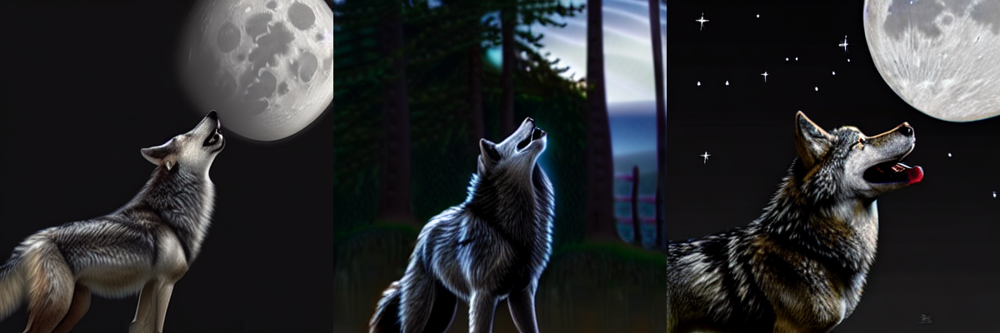

In [22]:
torch.manual_seed(1000)
prompt = "Wolf howling at the moon, photorealistic 4K"
images = pipe(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3)

  0%|          | 0/40 [00:00<?, ?it/s]

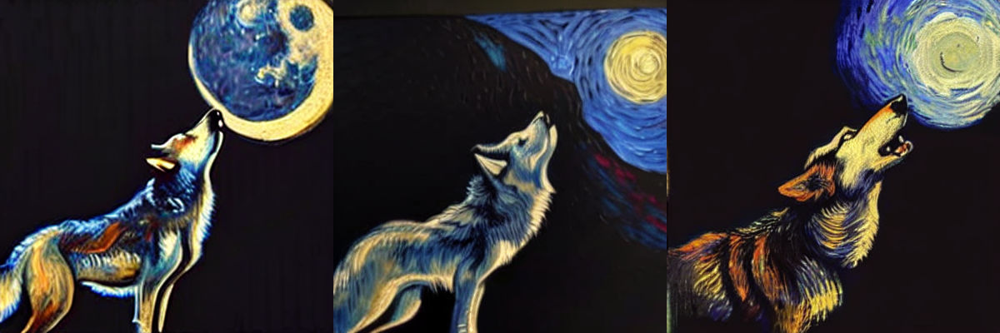

In [23]:
init_image = images[0]
torch.manual_seed(1000)
prompt = "An oil painting of a wolf howling at the moon in Vincent Van Gogh style"
images = pipe(prompt=prompt, num_images_per_prompt=3, image=init_image, strength=0.8, num_inference_steps=50).images
image_grid(images, rows=1, cols=3)

# Stable Diffusion - 1 step deeper - Inside the pipe



In [ ]:
'''
Auto Encoder - VAE - To convert images to latents.
UNet - Which predicts the noise given the latents
Text Encoder - Which encodes text to latents.
'''



  0%|          | 0/50 [00:00<?, ?it/s]

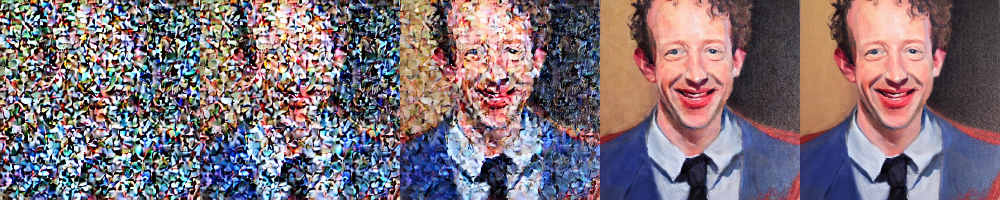

In [32]:
vae = pipe.vae
images = []

def latents_callback(i, t, latents):

    # scaling
    latents = 1 / 0.18215 * latents
    # Decoding
    image = vae.decode(latents).sample[0]
    # post processing the image - provided in the paper - And converting to an image
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))

prompt = "Portrait painting of Jeremy Howard looking happy."
torch.manual_seed(9000)
final_image = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
images.append(final_image)
image_grid(images, rows=1, cols=len(images))

In [3]:
from transformers import CLIPTextModel, CLIPTokenizer

In [4]:
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16)
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16).to("cuda")

In [5]:
from diffusers import AutoencoderKL, UNet2DConditionModel
# Here we use a different VAE to the original release, which has been fine-tuned for more steps
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-ema", torch_dtype=torch.float16).to("cuda")
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", torch_dtype=torch.float16).to("cuda")

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


In [6]:
from diffusers import LMSDiscreteScheduler
beta_start, beta_end = 0.00085, 0.012
scheduler = LMSDiscreteScheduler(beta_start = beta_start, beta_end = beta_end, beta_schedule = "scaled_linear", num_train_timesteps = 1000)

In [7]:
prompt = ['A photograph of an astronaut riding a horse']

height, width = 512, 512
num_inference_steps = 60
guidance_scale = 7.5
batch_size = 1

In [8]:
# Get text embeddings - pad -> tokenize -> Embeddings -> Encoder -> Final Textual Latents
text_input = tokenizer(prompt, padding="max_length", max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt")
text_input['input_ids'], len(text_input['input_ids'])

(tensor([[49406,   320,  8853,   539,   550, 18376,  6765,   320,  4558, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
          49407, 49407, 49407, 49407, 49407, 49407, 49407]]),
 1)

In [9]:
text_input['input_ids'].shape

torch.Size([1, 77])

In [ ]:
text_encoder

In [12]:
embs = text_encoder(text_input['input_ids'].to('cuda'))[0].half()

In [13]:
embs.shape

torch.Size([1, 77, 768])

In [14]:
# Reasonabily looking image - Unconditional Embeddings

uncond_input = ['']
uncond_embs = text_encoder(tokenizer(uncond_input, padding = 'max_length', max_length = embs.shape[1], return_tensors = 'pt')['input_ids'].to('cuda'))[0].half()

In [15]:
uncond_embs.shape, uncond_embs

(torch.Size([1, 77, 768]),
 tensor([[[-0.3884,  0.0229, -0.0523,  ..., -0.4902, -0.3066,  0.0674],
          [-0.3718, -1.4502, -0.3403,  ...,  0.9492,  0.1862, -1.1016],
          [-0.5112, -1.4619, -0.2927,  ...,  1.0410,  0.0698, -1.0283],
          ...,
          [ 0.4998, -0.9565, -0.6621,  ...,  1.6006, -1.0625, -0.2192],
          [ 0.4983, -0.9473, -0.6631,  ...,  1.6475, -1.0859, -0.2098],
          [ 0.4919, -0.8145, -0.4919,  ...,  1.6104, -1.0176, -0.2484]]],
        device='cuda:0', dtype=torch.float16, grad_fn=<NativeLayerNormBackward0>))

In [16]:
text_embs = torch.cat([uncond_embs, embs], dim = 0)
text_embs.shape

torch.Size([2, 77, 768])

In [17]:
unet.config.sample_size

64

In [37]:
torch.manual_seed(100)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents.shape

torch.Size([1, 4, 64, 64])

In [38]:
# Verifying weather its Gaussian Distribution or not.
torch.mean(latents), torch.std(latents)

(tensor(0.0010, device='cuda:0', dtype=torch.float16),
 tensor(1.0039, device='cuda:0', dtype=torch.float16))

In [21]:
'''
We have noisy latents
We have text embeddings
We have a scheduler

Now lets apply Diffusion Process
'''

scheduler.set_timesteps(num_inference_steps)

In [39]:
latents = latents * scheduler.init_noise_sigma

In [23]:
torch.mean(latents), torch.std(latents)

(tensor(-0.0035, device='cuda:0', dtype=torch.float16),
 tensor(14.5938, device='cuda:0', dtype=torch.float16))

In [24]:
scheduler.init_noise_sigma

tensor(14.6146)

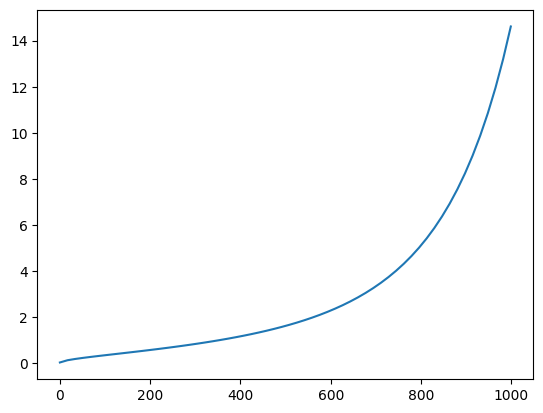

In [25]:
plt.plot(scheduler.timesteps, scheduler.sigmas[:-1]);

In [40]:
scheduler.set_timesteps(num_inference_steps)
for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = text_embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

  0%|          | 0/60 [00:00<?, ?it/s]

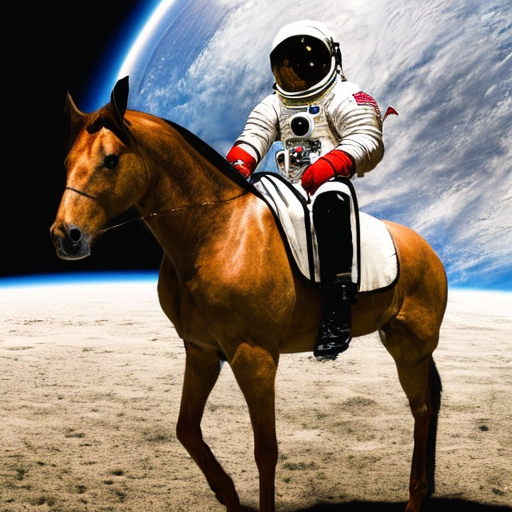

In [41]:
# Decode the latents using a VAE and then display the image

with torch.no_grad():
  image = vae.decode(1 / 0.18215 * latents).sample

image = (image / 2 + 0.5).clamp(0, 1)
image = image[0].detach().cpu().permute(1, 2, 0).numpy()
image = (image * 255).round().astype("uint8")
Image.fromarray(image)


In [10]:
# Function to get text embeddings

def encode_text(inputs = ['']):

    uncond_inputs = [''] * len(inputs)
    all_inputs = uncond_inputs + inputs
    all_inputs_tokenized = tokenizer(all_inputs, padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda')
    embeddings = text_encoder(all_inputs_tokenized)[0].half()
    return embeddings

embs = encode_text(['Indiana Jones running on a train', 'Albert Einstein fighting with Adolf Hitler'])
# Function to do the diffusion loop and spit back the latents


In [11]:
embs.shape

torch.Size([4, 77, 768])

In [12]:
def run_diffusion_loop(latents, scheduler, embs, batch_size, gs = 7.5):

    for i, t in enumerate(tqdm(scheduler.timesteps)):
        # Concat and  Scale the latents
        latent_input = torch.cat([latents]*(batch_size), dim = 0)
        latent_input = scheduler.scale_model_input(latent_input, t)

        # Predict the noise
        with torch.no_grad():
            noise_preds = unet(latent_input, t, encoder_hidden_states = embs).sample

        n_u, n_t = noise_preds.chunk(2)
        pred = n_u + gs * (n_t - n_u)

        # Scheduler.step
        latents = scheduler.step(pred, t, latents).prev_sample

    return latents


In [13]:
latents = torch.randn((2, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents.shape

torch.Size([2, 4, 64, 64])

In [14]:
scheduler.init_noise_sigma

tensor(14.6146)

In [15]:
latents = latents * scheduler.init_noise_sigma

In [18]:
scheduler.set_timesteps(num_inference_steps)
denoised_latents = run_diffusion_loop(latents, scheduler, embs, latents.shape[0], gs = 7.5)

  0%|          | 0/60 [00:00<?, ?it/s]

In [19]:
denoised_latents.shape

torch.Size([2, 4, 64, 64])

In [20]:
def decode(latents):

  with torch.no_grad():
    images = vae.decode(1 / 0.18215 * latents).sample
  return images

def show_image(image):
  image = (image / 2 + 0.5).clamp(0, 1)
  image = image.detach().cpu().permute(1, 2, 0).numpy()
  image = (image * 255).round().astype("uint8")
  return Image.fromarray(image)



In [21]:
images = decode(denoised_latents)


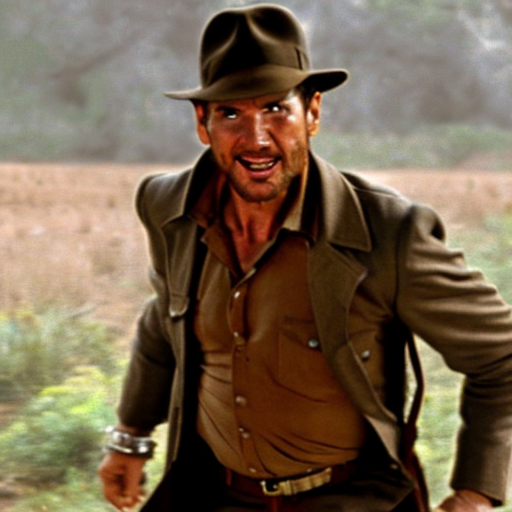

In [22]:
show_image(images[0])

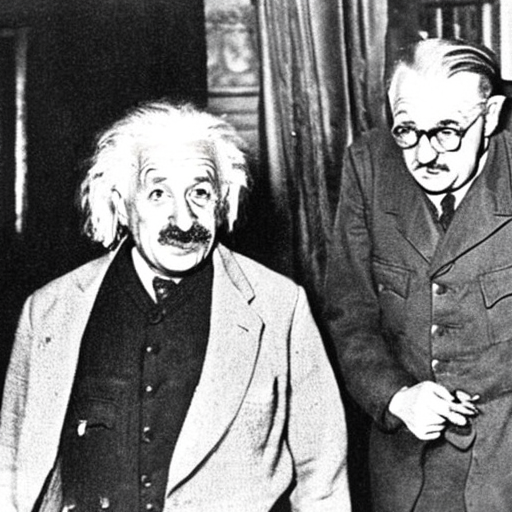

In [23]:
show_image(images[1])

# Playing around with Latents and Unconditional Latents


In [65]:
def encode_text(inputs = ['']):

    uncond_inputs = [''] * len(inputs)
    all_inputs = uncond_inputs + inputs
    all_inputs_tokenized = tokenizer(all_inputs, padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda')
    embeddings = text_encoder(all_inputs_tokenized)[0].half()
    return embeddings


In [24]:
torch.manual_seed(100)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents.shape

torch.Size([1, 4, 64, 64])

In [26]:
embs = text_encoder(tokenizer([''], padding = 'max_length', max_length = tokenizer.model_max_length, truncation = True, return_tensors = "pt").input_ids.to('cuda'))[0].half()

In [27]:
embs.shape

torch.Size([1, 77, 768])

  0%|          | 0/60 [00:00<?, ?it/s]

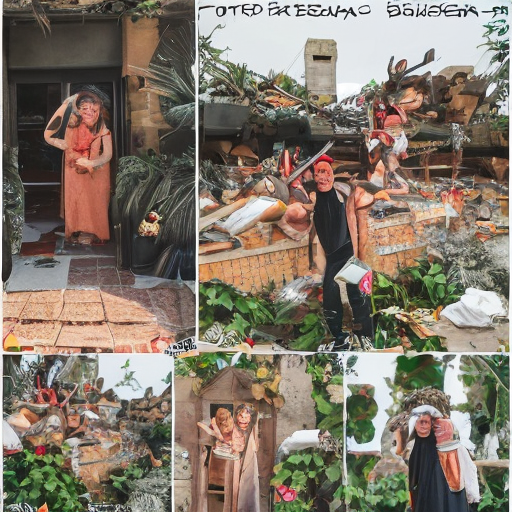

In [33]:
torch.manual_seed(100)
scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  # input = torch.cat([latents]*2)
  input = latents
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  # n_u, n_p = noise_pred.chunk(2)
  # pred = n_u + guidance_scale * (n_p - n_u)

  latents = scheduler.step(noise_pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

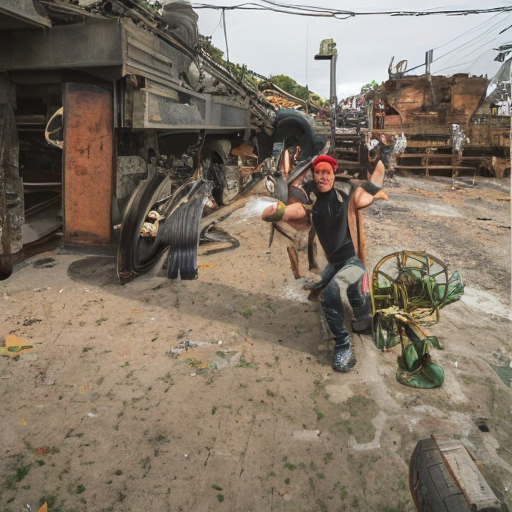

In [34]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['Indiana Jones running on a train'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  # input = torch.cat([latents]*2)
  input = latents
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  # n_u, n_p = noise_pred.chunk(2)
  # pred = n_u + guidance_scale * (n_p - n_u)

  latents = scheduler.step(noise_pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

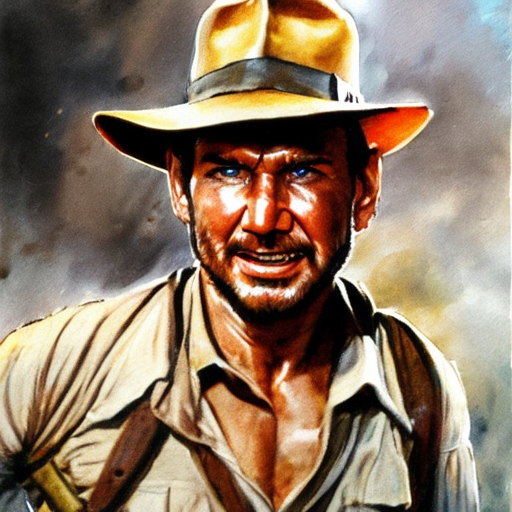

In [45]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

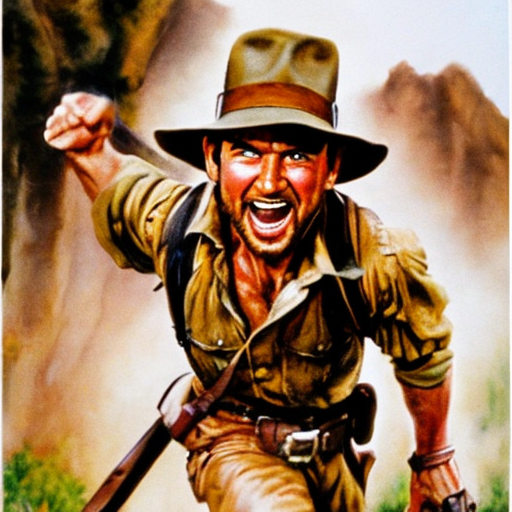

In [44]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['Blue Whale in deep sea staring at moon', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

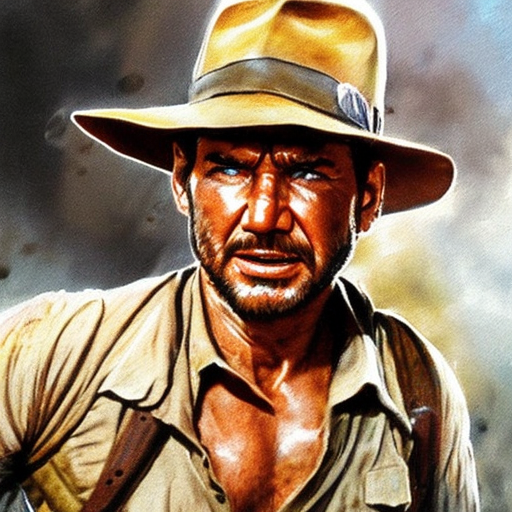

In [43]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['alpha beta gamma delta epsilon', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

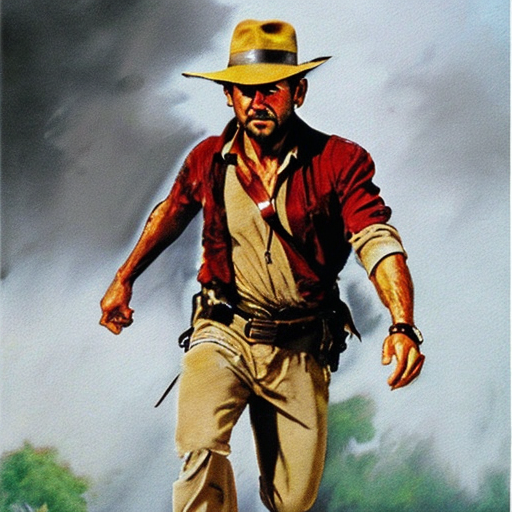

In [42]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['A room full of fluffy persian cats purring', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

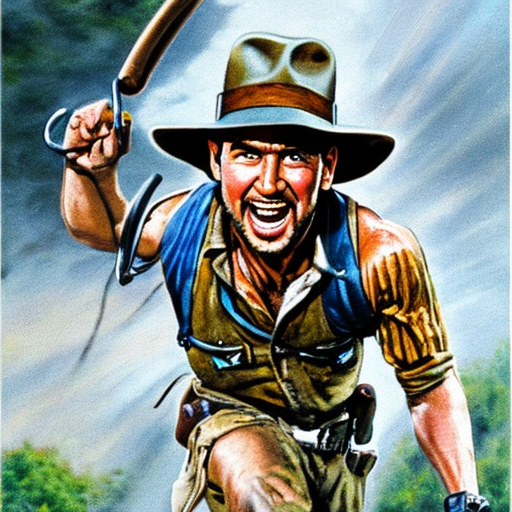

In [46]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['A room full of red fluffy persian cats purring', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])

  0%|          | 0/60 [00:00<?, ?it/s]

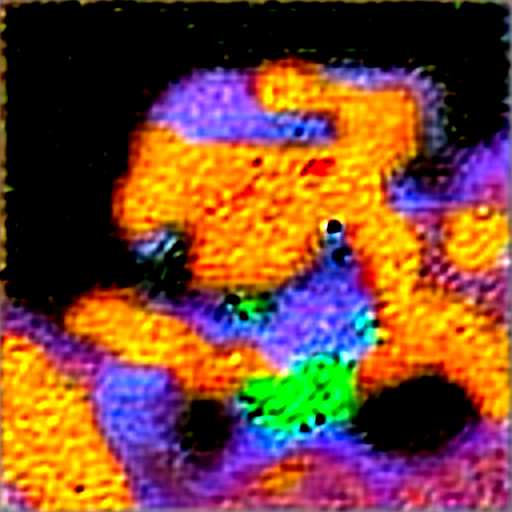

In [49]:
torch.manual_seed(100)
embs = text_encoder(tokenizer(['', 'A water painting of Indiana Jones running on a train with a hat on his head'], padding = 'max_length', max_length = tokenizer.model_max_length, truncation=True, return_tensors="pt").input_ids.to('cuda'))[0].half()

scheduler.set_timesteps(num_inference_steps)
latents = torch.randn((1, unet.config.in_channels, unet.config.sample_size, unet.config.sample_size)).to('cuda').half()
latents = latents * scheduler.init_noise_sigma

for i, t in enumerate(tqdm(scheduler.timesteps)):
  input = torch.cat([latents]*2, dim = 0)
  input = scheduler.scale_model_input(input, t)

  # Predict the Noise
  with torch.no_grad():
    noise_pred = unet(input, t, encoder_hidden_states = embs).sample

  n_u, n_p = noise_pred.chunk(2)
  pred = n_u + guidance_scale * (n_p - n_u) / torch.norm(n_p - n_u) * torch.norm(n_u)
  # pred = guidance_scale * (n_p - n_u)

  latents = scheduler.step(pred, t, latents).prev_sample

images = decode(latents)
show_image(images[0])